# Úvod

![meme](https://i.pinimg.com/474x/4a/40/ba/4a40ba8df294a3566edf8f0e3013ed68.jpg)

**Rotten Tomatoes** je jedním z nejlepších zdrojů pro recenze filmových kritiků. Tento dataset obsahuje informace o filmech, jejich žánrech, hodnoceních uživatelů (*audience score*) a kritiků (*tomatometer*). Data byla získána scrapingem z veřejně dostupné webové stránky [Rotten Tomatoes](https://www.rottentomatoes.com) k datu **31. 10. 2020**. Cílem analýzy je porovnat recenze kritiků s hodnoceními uživatelů a odhalit případné rozdíly.

[Odkaz](https://www.kaggle.com/datasets/stefanoleone992/rotten-tomatoes-movies-and-critic-reviews-dataset/data) na Kaggle dataset.


# Načtení knihoven

In [1]:
import absl.logging
absl.logging.set_verbosity('error')

import random
from pathlib import Path
import os
from collections import Counter
import re
import time
import pickle
import dill

import kagglehub
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
from wordcloud import WordCloud

import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer

from sklearn.metrics import classification_report, confusion_matrix, accuracy_score

import optuna
from optuna.samplers import TPESampler
from optuna.visualization import (
    plot_optimization_history, plot_parallel_coordinate, 
    plot_param_importances, plot_contour, plot_slice,
    plot_edf, plot_timeline, plot_rank
)

from transformers import TFDistilBertForSequenceClassification, DistilBertTokenizer
from transformers import create_optimizer

import tensorflow as tf
from tensorflow.keras import backend as K
from tensorflow.keras.callbacks import (
	ModelCheckpoint, TensorBoard, EarlyStopping
)
from tensorflow.keras.initializers import Constant
from tensorflow.keras.layers import (
	Input, Embedding, LSTM, TextVectorization, Flatten, Dense, Dropout, 
	Bidirectional, Conv1D, GlobalMaxPooling1D, Concatenate, 
	GlobalAveragePooling1D, BatchNormalization, RepeatVector, 
	Activation, Permute, Multiply, Lambda
)
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.utils import to_categorical

2025-06-14 02:01:13.575264: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1749859273.589957   13778 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1749859273.594190   13778 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1749859273.605689   13778 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1749859273.605727   13778 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1749859273.605731   13778 computation_placer.cc:177] computation placer alr

## NTLK data

In [2]:
try:
	nltk.data.find('corpora/stopwords')
	nltk.data.find('corpora/wordnet')
except LookupError:
	nltk.download('stopwords', quiet=True)
	nltk.download('wordnet', quiet=True)

# Nastavení stejného náhodného prostředí

In [3]:
SEED = 42

random.seed(SEED)
np.random.seed(SEED)
os.environ['PYTHONHASHSEED'] = str(SEED)
tf.config.experimental.enable_op_determinism()
os.environ['TF_DETERMINISTIC_OPS'] = '1'
tf.random.set_seed(SEED)

# Načtení dat

In [4]:
path = kagglehub.dataset_download("stefanoleone992/rotten-tomatoes-movies-and-critic-reviews-dataset")

In [5]:
%ls ~/.cache/kagglehub/datasets/stefanoleone992/rotten-tomatoes-movies-and-critic-reviews-dataset/versions/1

rotten_tomatoes_critic_reviews.csv  rotten_tomatoes_movies.csv


In [6]:
file_path = Path(path) / "rotten_tomatoes_critic_reviews.csv"
df = pd.read_csv(file_path)
df.head()

,rotten_tomatoes_link,critic_name,top_critic,publisher_name,review_type,review_score,review_date,review_content
0,m/0814255,Andrew L. Urban,False,Urban Cinefile,Fresh,NaN,2010-02-06,A fantasy adventure that fuses Greek mythology...
1,m/0814255,Louise Keller,False,Urban Cinefile,Fresh,NaN,2010-02-06,"Uma Thurman as Medusa, the gorgon with a coiff..."
2,m/0814255,NaN,False,FILMINK (Australia),Fresh,NaN,2010-02-09,With a top-notch cast and dazzling special eff...
3,m/0814255,Ben McEachen,False,Sunday Mail (Australia),Fresh,3.5/5,2010-02-09,Whether audiences will get behind The Lightnin...
4,m/0814255,Ethan Alter,True,Hollywood Reporter,Rotten,NaN,2010-02-10,What's really lacking in The Lightning Thief i...


In [7]:
movies_path = Path(path) / "rotten_tomatoes_movies.csv"
df_movies = pd.read_csv(movies_path)
df_movies.head()

,rotten_tomatoes_link,movie_title,movie_info,critics_consensus,content_rating,genres,directors,authors,actors,original_release_date,...,production_company,tomatometer_status,tomatometer_rating,tomatometer_count,audience_status,audience_rating,audience_count,tomatometer_top_critics_count,tomatometer_fresh_critics_count,tomatometer_rotten_critics_count
0,m/0814255,Percy Jackson & the Olympians: The Lightning T...,"Always trouble-prone, the life of teenager Per...",Though it may seem like just another Harry Pot...,PG,"Action & Adventure, Comedy, Drama, Science Fic...",Chris Columbus,"Craig Titley, Chris Columbus, Rick Riordan","Logan Lerman, Brandon T. Jackson, Alexandra Da...",2010-02-12,...,20th Century Fox,Rotten,49.0,149.0,Spilled,53.0,254421.0,43,73,76
1,m/0878835,Please Give,Kate (Catherine Keener) and her husband Alex (...,Nicole Holofcener's newest might seem slight i...,R,Comedy,Nicole Holofcener,Nicole Holofcener,"Catherine Keener, Amanda Peet, Oliver Platt, R...",2010-04-30,...,Sony Pictures Classics,Certified-Fresh,87.0,142.0,Upright,64.0,11574.0,44,123,19
2,m/10,10,"A successful, middle-aged Hollywood songwriter...",Blake Edwards' bawdy comedy may not score a pe...,R,"Comedy, Romance",Blake Edwards,Blake Edwards,"Dudley Moore, Bo Derek, Julie Andrews, Robert ...",1979-10-05,...,Waner Bros.,Fresh,67.0,24.0,Spilled,53.0,14684.0,2,16,8
3,m/1000013-12_angry_men,12 Angry Men (Twelve Angry Men),Following the closing arguments in a murder tr...,Sidney Lumet's feature debut is a superbly wri...,NR,"Classics, Drama",Sidney Lumet,Reginald Rose,"Martin Balsam, John Fiedler, Lee J. Cobb, E.G....",1957-04-13,...,Criterion Collection,Certified-Fresh,100.0,54.0,Upright,97.0,105386.0,6,54,0
4,m/1000079-20000_leagues_under_the_sea,"20,000 Leagues Under The Sea","In 1866, Professor Pierre M. Aronnax (Paul Luk...","One of Disney's finest live-action adventures,...",G,"Action & Adventure, Drama, Kids & Family",Richard Fleischer,Earl Felton,"James Mason, Kirk Douglas, Paul Lukas, Peter L...",1954-01-01,...,Disney,Fresh,89.0,27.0,Upright,74.0,68918.0,5,24,3


Spolu s recenzemi byly načteny i názvy filmů a jejich žánry 🎬.  

Protože se zaměřujeme na klasifikaci, tento soubor s informacemi o filmech dále nevyužijeme ❌ — klasifikace zde není možná a pro recenze jej nelze použít 📝.

# EDA

Cílem anlýzy je vlastně přijít na to, který atribut vybereme pro klasifikaci, jelikož jich tu máme více. To a samozřejmě i ostatní informace a vizualizace.

## Základní statistiky

In [8]:
df.head()

,rotten_tomatoes_link,critic_name,top_critic,publisher_name,review_type,review_score,review_date,review_content
0,m/0814255,Andrew L. Urban,False,Urban Cinefile,Fresh,NaN,2010-02-06,A fantasy adventure that fuses Greek mythology...
1,m/0814255,Louise Keller,False,Urban Cinefile,Fresh,NaN,2010-02-06,"Uma Thurman as Medusa, the gorgon with a coiff..."
2,m/0814255,NaN,False,FILMINK (Australia),Fresh,NaN,2010-02-09,With a top-notch cast and dazzling special eff...
3,m/0814255,Ben McEachen,False,Sunday Mail (Australia),Fresh,3.5/5,2010-02-09,Whether audiences will get behind The Lightnin...
4,m/0814255,Ethan Alter,True,Hollywood Reporter,Rotten,NaN,2010-02-10,What's really lacking in The Lightning Thief i...


Vidíme, že `rotten_tomatoes_link` obsahuje odkazy na recenze 🔗, které nám během dalšího počínání nijak nepomohou.  
Proto tento sloupec můžeme rovnou vypustit 🗑️.

In [9]:
df = df.drop(columns=["rotten_tomatoes_link"])
df.head()

,critic_name,top_critic,publisher_name,review_type,review_score,review_date,review_content
0,Andrew L. Urban,False,Urban Cinefile,Fresh,NaN,2010-02-06,A fantasy adventure that fuses Greek mythology...
1,Louise Keller,False,Urban Cinefile,Fresh,NaN,2010-02-06,"Uma Thurman as Medusa, the gorgon with a coiff..."
2,NaN,False,FILMINK (Australia),Fresh,NaN,2010-02-09,With a top-notch cast and dazzling special eff...
3,Ben McEachen,False,Sunday Mail (Australia),Fresh,3.5/5,2010-02-09,Whether audiences will get behind The Lightnin...
4,Ethan Alter,True,Hollywood Reporter,Rotten,NaN,2010-02-10,What's really lacking in The Lightning Thief i...


In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1130017 entries, 0 to 1130016
Data columns (total 7 columns):
 #   Column          Non-Null Count    Dtype 
---  ------          --------------    ----- 
 0   critic_name     1111488 non-null  object
 1   top_critic      1130017 non-null  bool  
 2   publisher_name  1130017 non-null  object
 3   review_type     1130017 non-null  object
 4   review_score    824081 non-null   object
 5   review_date     1130017 non-null  object
 6   review_content  1064211 non-null  object
dtypes: bool(1), object(6)
memory usage: 52.8+ MB


In [11]:
df.shape

(1130017, 7)

Páni, máme zde **1 130 017** instancí a _8_ sloupců. 

### Názvy sloupců

In [12]:
print(*df.columns, sep="\n")

critic_name
top_critic
publisher_name
review_type
review_score
review_date
review_content


### Počet chybějících hodnot pro každý sloupec

In [13]:
for col in df.columns:
	print(f"{col}: {df[col].isna().sum()}")

critic_name: 18529
top_critic: 0
publisher_name: 0
review_type: 0
review_score: 305936
review_date: 0
review_content: 65806


Vidíme, že jediné atributy, které obsahují chybějící hodnoty, jsou `critic_name`, `review_score`, `publisher_name` a `review_context`.  
Všechny ostatní sloupce jsou kompletní ✅.

`critic_name` obsahuje jména jednotlivých autorů recenzí, což pro náš účel není relevantní.  
Proto jej můžeme vypustit 🗑️. Stejně tak jako `top_critic` a `review_date`, které neposkytují žádné užitečné informace pro klasifikaci.  
Mohli bychom si na nich ukázat pár pěkných vizualizací, ale proč si komplikovat život, že? 😄

Chybějící hodnoty v `review_content`, což bude hlavní atribut pro klasifikaci, asi nějak přežijeme — máme **1 130 017** instancí.


In [14]:
columns_to_drop = ["critic_name", "top_critic", "review_date", "publisher_name"]

## Výběr klíčového atributu

Na výběr máme dvě možnosti:
- `review_score` – číselné hodnocení recenze v rozsahu od 0 do 100.
- `review_type` – kategorizované označení recenze s hodnotami **Fresh** (čerstvá) a **Rotten** (shnilá), reprezentující pozitivní nebo negativní hodnocení.

Obě dvě možnosti jsou vhodné pro klasifikaci. Pojdmě se na ně podívat blíže.

In [15]:
print(f"Unikátní hodnoty v 'review_score': {df['review_score'].count()}")
print(df["review_score"].sample(10, random_state=SEED))
print(f"Počet chybějících hodnot v 'review_score': {df['review_score'].isna().sum()}")

Unikátní hodnoty v 'review_score': 824081
1016770      2/5
515691       4/5
319368       NaN
183078      6/10
640819     2.5/4
601012       3/5
647251      8/10
283290       NaN
847580       NaN
975940       NaN
Name: review_score, dtype: object
Počet chybějících hodnot v 'review_score': 305936


In [16]:
print(f"Unikátní hodnoty v 'review_type': {df['review_type'].unique()}")
print(f"Počet chybějících hodnot v 'review_type': {df['review_type'].isna().sum()}")

Unikátní hodnoty v 'review_type': ['Fresh' 'Rotten']
Počet chybějících hodnot v 'review_type': 0


Vybereme `review_type`, protože `review_score` není unifikované hodnocení, chybějí v něm hodnoty a `review_type` je lepší — je kompletní a jednotné ✅.  
U `review_score` navíc máme **824 081** různých hodnot! 😵

Proto se můžeme rovnou zbavit sloupce `review_score`, který nebudeme potřebovat a ani ho nijak vizualizovat.  
Jeho sjednocení do jednoho formátu by bylo prakticky nemožné a klasifikaci by nijak nepomohlo. 🗑️

![meme](https://media.makeameme.org/created/these-rotten-tomatoes-7e2d470239.jpg)

In [17]:
columns_to_drop.append("review_score")

In [18]:
key_columns = "review_type"

## Atribut pro obsah recenze

### Průměrná délka recenze

In [19]:
df["review_content"].str.len().mean()

np.float64(128.00649495259867)

### Medianí délky recenze

In [20]:
df['review_content'].str.len().median()

np.float64(127.0)

### Maximální délka recenze

In [21]:
df['review_content'].str.len().max()

np.float64(258.0)

### Minimální délka recenze

In [22]:
df['review_content'].str.len().min()

np.float64(1.0)

### Spodní kvartil délky recenze

In [23]:
df['review_content'].str.len().quantile(0.25)

np.float64(86.0)

### Horní kvartil délky recenze

In [24]:
df["review_content"].str.len().quantile(0.75)

np.float64(167.0)

### Ukázka několika recenzí

In [25]:
for i in range(5):
	idx = random.randint(0, len(df) - 1)
	review_text = df['review_content'].iloc[idx]
	review_type = df['review_type'].iloc[idx]
	
	type_color = "\033[92m" if review_type == "Fresh" else "\033[91m"
	
	print(f"\nRecenze {i+1} ({type_color}{review_type}\033[0m):")
	print("-" * 80)
	if pd.isna(review_text):
		print("Text recenze není dostupný")
	else:
		print(review_text[:500] + "..." if len(review_text) > 500 else review_text)
	print("-" * 80)


Recenze 1 (Fresh):
--------------------------------------------------------------------------------
Bizarrely entertaining and brilliantly designed.
--------------------------------------------------------------------------------

Recenze 2 (Fresh):
--------------------------------------------------------------------------------
[Generosity] seems to resonate in Andrew Dickson's sweet, melancholy score, in Dick Pope's tactfully beautiful images and in every frame of this sad, resolute film.
--------------------------------------------------------------------------------

Recenze 3 (Rotten):
--------------------------------------------------------------------------------
Call me picky, but I want my movies about miracles to leave me with wonder in my eyes, along with a tear or two.
--------------------------------------------------------------------------------

Recenze 4 (Fresh):
--------------------------------------------------------------------------------
One of the very best film

## Vizualizace

Zbyly nám jen dva sloupce: `review_type` a `review_content`. Pojdmě se na ně podívat blíže...

### Rozložení recenzí podle typu recenze

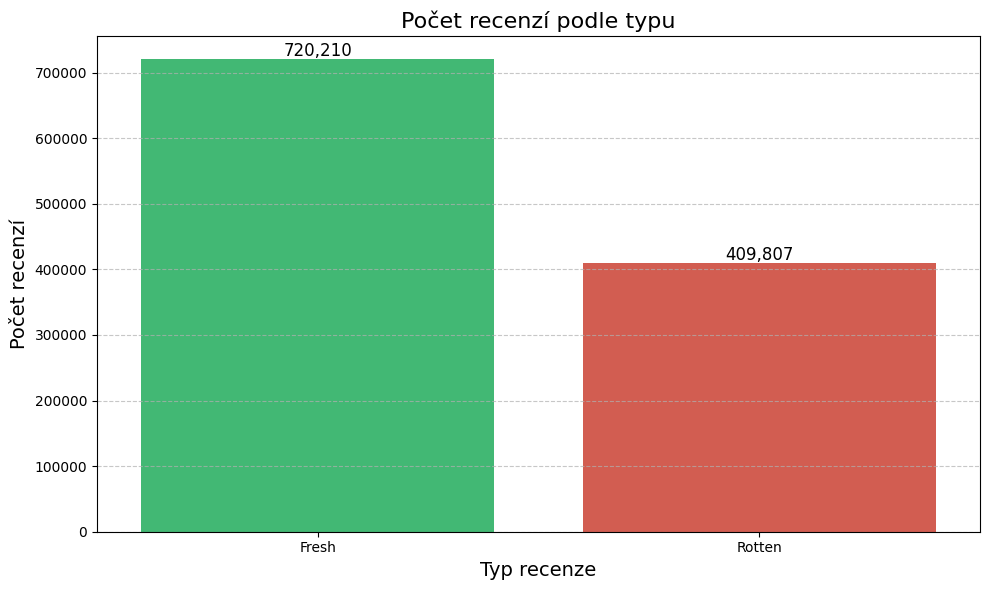

In [26]:
review_type_counts = df[key_columns].value_counts()

custom_palette_colors = ['#2ecc71', '#e74c3c']

plt.figure(figsize=(10, 6))
sns.barplot(x=review_type_counts.index, y=review_type_counts.values, hue=review_type_counts.index, palette=custom_palette_colors, legend=False)

for i, v in enumerate(review_type_counts.values):
	plt.text(i, v + 5000, f"{v:,}", ha='center', fontsize=12)

plt.title("Počet recenzí podle typu", fontsize=16)
plt.xlabel("Typ recenze", fontsize=14)
plt.ylabel("Počet recenzí", fontsize=14)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

Vidíme, že máme stále dostatek dat pro obě kategorie recenzí ✅.  
**Fresh** recenzí máme **720 210** 🥦 a **Rotten** recenzí **409 807** 🍅.  
To je více než dostatečné množství pro klasifikaci 💡.


#### Procentuální zastoupení jednotlivých typů recenzí

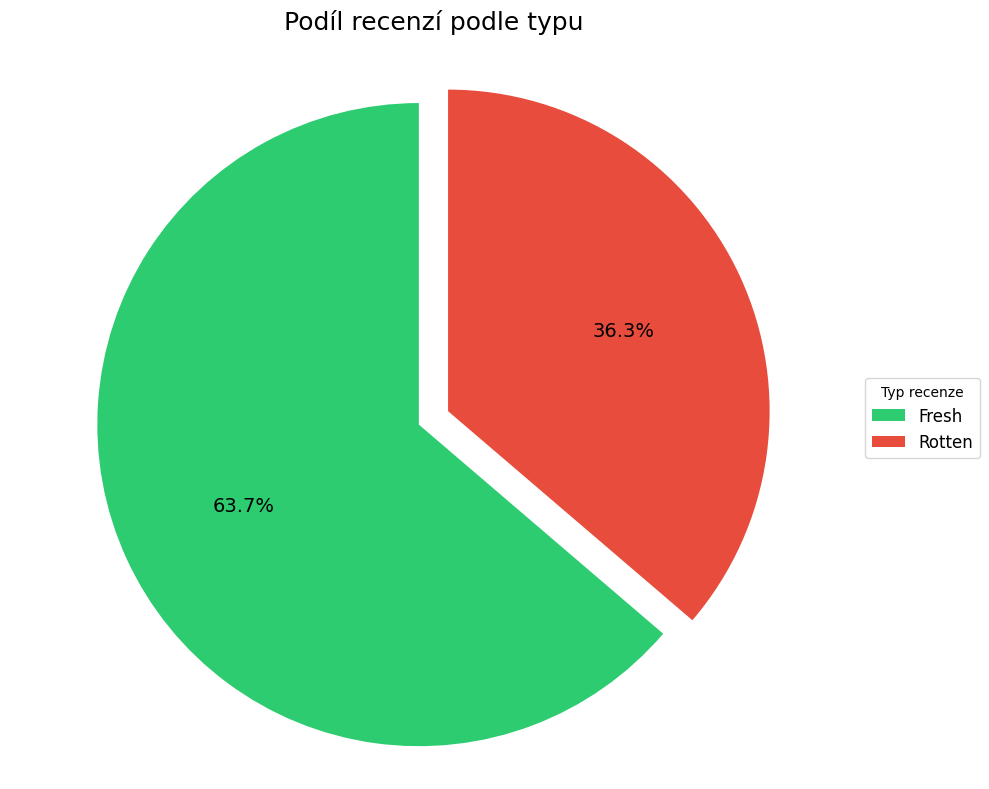

In [27]:
plt.figure(figsize=(10, 8))
explode = (0.05, 0.05) 
wedges, texts, autotexts = plt.pie(
	review_type_counts.values, 
	labels=None,  # Remove default labels
	autopct='%1.1f%%',
	startangle=90, 
	colors=custom_palette_colors,
	explode=explode,
	shadow=False,
	textprops={'fontsize': 14}
)

plt.legend(
	wedges, 
	review_type_counts.index,
	title="Typ recenze",
	loc="center left",
	bbox_to_anchor=(1, 0.5),
	fontsize=12
)

plt.title("Podíl recenzí podle typu", fontsize=18, pad=20)
plt.axis('equal')
plt.tight_layout()
plt.show()


#### Rozložení recenzí podle typu recenze bez chybějících hodnot

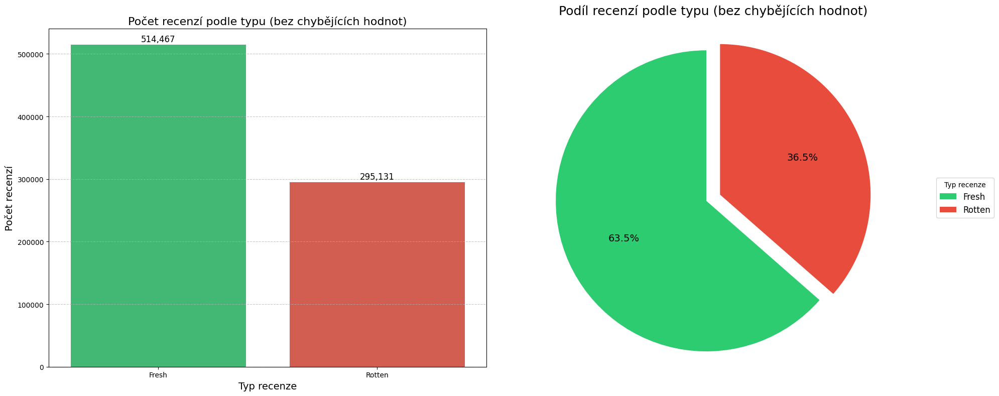

In [28]:
df_no_na = df.dropna(subset=columns_to_drop)
fig, axes = plt.subplots(1, 2, figsize=(20, 8))
review_type_counts_no_na = df_no_na[key_columns].value_counts()
sns.barplot(
	x=review_type_counts_no_na.index, 
	y=review_type_counts_no_na.values, 
	hue=review_type_counts_no_na.index, 
	palette=custom_palette_colors, 
	legend=False, 
	ax=axes[0]
)
for i, v in enumerate(review_type_counts_no_na.values):
	axes[0].text(i, v + 5000, f"{v:,}", ha='center', fontsize=12)
axes[0].set_title("Počet recenzí podle typu (bez chybějících hodnot)", fontsize=16)
axes[0].set_xlabel("Typ recenze", fontsize=14)
axes[0].set_ylabel("Počet recenzí", fontsize=14)
axes[0].grid(axis='y', linestyle='--', alpha=0.7)
wedges, texts, autotexts = axes[1].pie(
	review_type_counts_no_na.values, 
	labels=None,  
	autopct='%1.1f%%',
	startangle=90, 
	colors=custom_palette_colors,
	explode=explode,
	shadow=False,
	textprops={'fontsize': 14}
)
axes[1].legend(
	wedges, 
	review_type_counts_no_na.index,
	title="Typ recenze",
	loc="center left",
	bbox_to_anchor=(1, 0.5),
	fontsize=12
)
axes[1].set_title("Podíl recenzí podle typu (bez chybějících hodnot)", fontsize=18, pad=20)
axes[1].axis('equal')
plt.tight_layout()
plt.show()

In [29]:
comparison_df = pd.DataFrame({
	'Počet recenzí (všechna data)': review_type_counts.values,
	'Počet recenzí (bez chybějících hodnot)': review_type_counts_no_na.values,
	'Rozdíl': review_type_counts - review_type_counts_no_na,
	'Rozdíl (%)': ((review_type_counts - review_type_counts_no_na) / review_type_counts * 100).round(2)
}, index=review_type_counts.index)

total_row = pd.Series({
	'Počet recenzí (všechna data)': review_type_counts.sum(),
	'Počet recenzí (bez chybějících hodnot)': review_type_counts_no_na.sum(),
	'Rozdíl': (review_type_counts - review_type_counts_no_na).sum(),
	'Rozdíl (%)': ((review_type_counts - review_type_counts_no_na).sum() / review_type_counts.sum() * 100).round(2)
}, name='Celkem')

comparison_df = pd.concat([comparison_df, pd.DataFrame([total_row])])

for col in ['Počet recenzí (všechna data)', 'Počet recenzí (bez chybějících hodnot)', 'Rozdíl']:
	comparison_df[col] = comparison_df[col].apply(lambda x: f"{int(x):,}")

comparison_df['Rozdíl (%)'] = comparison_df['Rozdíl (%)'].apply(lambda x: f"{x:.2f}%")

comparison_df

,Počet recenzí (všechna data),Počet recenzí (bez chybějících hodnot),Rozdíl,Rozdíl (%)
Fresh,"720,210","514,467","205,743",28.57%
Rotten,"409,807","295,131","114,676",27.98%
Celkem,"1,130,017","809,598","320,419",28.36%


- U pozitivních recenzí (**Fresh**) jsme z původních **720 210** záznamů zachovali pouze **514 467** 📉, což znamená ztrátu **28,57 %** dat.
- U negativních recenzí (**Rotten**) klesl počet z **409 807** na **295 131** 📉, tedy o **27,98 %**.
- Celkově jsme z původní množiny **1 130 017** recenzí zachovali pouze **809 598** ✅, což představuje ztrátu **28,36 %** všech dat, tedy 320 419 záznamů.

Podobné procentuální úbytky v obou kategoriích naznačují, že chybějící hodnoty jsou rovnoměrně distribuované ⚖️ a neovlivňují významně poměr mezi pozitivními a negativními recenzemi.

### Délka jednotlivých recenzí

#### Distribuce délky recenzí

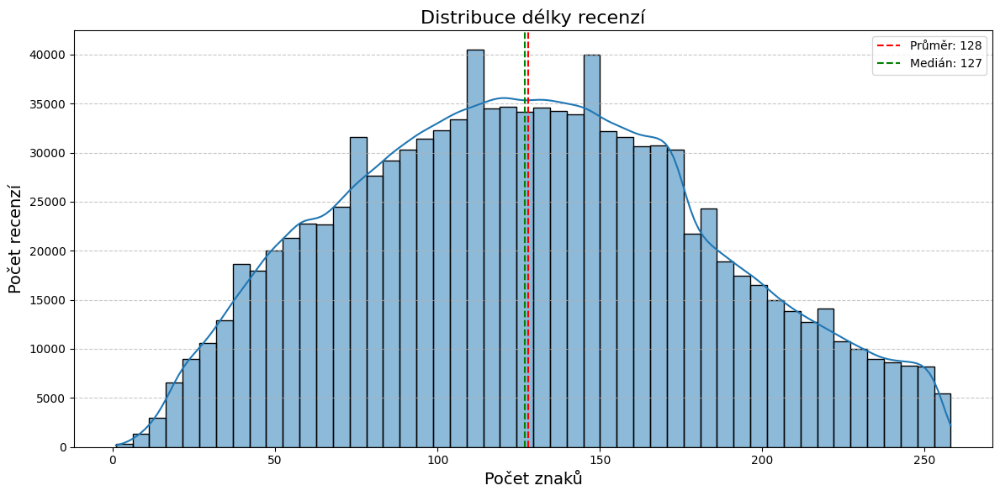

In [30]:
plt.figure(figsize=(12, 6))
sns.histplot(df['review_content'].str.len().dropna(), bins=50, kde=True)
plt.title('Distribuce délky recenzí', fontsize=16)
plt.xlabel('Počet znaků', fontsize=14)
plt.ylabel('Počet recenzí', fontsize=14)
plt.axvline(df['review_content'].str.len().mean(), color='red', linestyle='--', 
		   label=f'Průměr: {df["review_content"].str.len().mean():.0f}')
plt.axvline(df['review_content'].str.len().median(), color='green', linestyle='--', 
		   label=f'Medián: {df["review_content"].str.len().median():.0f}')
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

Vizualizace sedí se statistikami, které jsme si ukázali dříve 📊.  
Medián délky recenze je **127** a průměrná délka recenze **128**.  
Rozložení délky má normální tvar s mírným nakloněním doprava ➡️.

Podíváme-li se na distribuci krátkých recenzí (do 10 znaků), vidíme, že jich je celkem hodně ⚠️.  
Pro zarovnání použijeme průměrnou délku recenze, tedy **128** znaků.


In [31]:
char_counts = df['review_content'].str.len().value_counts().sort_index()
char_counts = char_counts[char_counts.index <= 10]
char_counts_dict = char_counts.to_dict()
print("Počty recenzí podle počtu znaků (1-10):")
for count, freq in char_counts_dict.items():
	print(f"{count} znaků: {freq} recenzí")


Počty recenzí podle počtu znaků (1-10):
1.0 znaků: 41 recenzí
2.0 znaků: 3 recenzí
3.0 znaků: 22 recenzí
4.0 znaků: 57 recenzí
5.0 znaků: 111 recenzí
6.0 znaků: 118 recenzí
7.0 znaků: 146 recenzí
8.0 znaků: 195 recenzí
9.0 znaků: 271 recenzí
10.0 znaků: 354 recenzí


![meme](https://preview.redd.it/8mcfwv4vv8281.jpg?width=1080&crop=smart&auto=webp&s=6fc749b61201869ec221ea68b7101c897194c794)

Pokud vezmeme v úvahu, že recenze může obsahovat jediné slovo, například „Great“, „Bad“, „Amazing“ atd., můžeme říci, že recenze s délkou do 10 znaků jsou v pořádku 👍.  

Přesto však odfiltrujeme recenze kratší než 2 znaky, protože ty už jsou opravdu velmi krátké a pravděpodobně neobsahují žádný smysluplný obsah 🚫.  

Jako hranici volím dvě znaky, protože recenze kratší než dva znaky jsou pouze jednoznakové – těch je 41 – a dvouznakové recenze mohou být například „OK“, „No“, „Yes“ atd., což už nějaký smysl dává ✔️.  

Je to malý počet, ale zamyslel jsem se nad tím 🤔.


#### Délka recenzí podle typu recenze

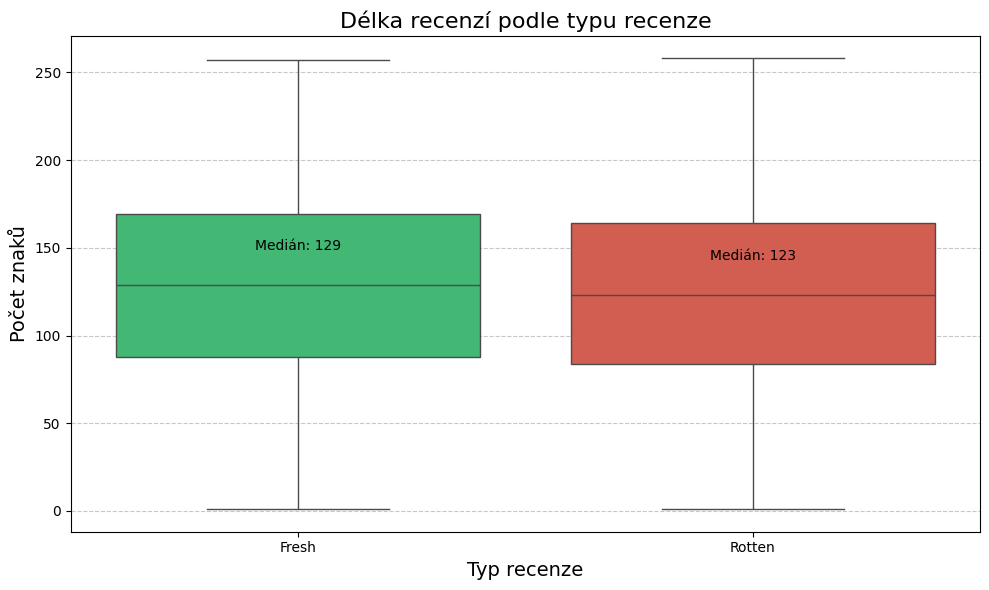

In [32]:
plt.figure(figsize=(10, 6))

temp_data = pd.DataFrame({
	'review_type': df['review_type'],
	'length': df['review_content'].str.len()
})

sns.boxplot(x='review_type', y='length', data=temp_data, hue='review_type', palette=custom_palette_colors, legend=False)
plt.title('Délka recenzí podle typu recenze', fontsize=16)
plt.xlabel('Typ recenze', fontsize=14)
plt.ylabel('Počet znaků', fontsize=14)
plt.grid(axis='y', linestyle='--', alpha=0.7)

medians = temp_data.groupby('review_type')['length'].median()
for i, review_type in enumerate(medians.index):
	plt.text(i, medians[review_type] + 20, f'Medián: {medians[review_type]:.0f}', 
			 ha='center', fontsize=10)
plt.tight_layout()
plt.show()

Distribuce jednotlivých tříd je velmi podobná, což je pro nás dobrá zpráva a můžeme použít znalosti získáné z předchozí vizualizace. 

#### Poečet slov v jednotlivých recenzích

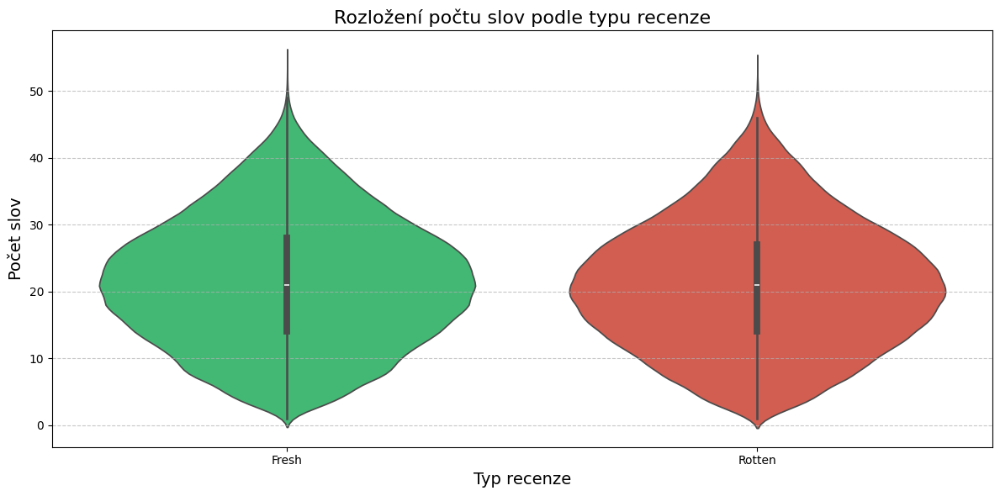

In [33]:
temp_data['word_count'] = df['review_content'].str.split().str.len()

plt.figure(figsize=(12, 6))
sns.violinplot(x='review_type', y='word_count', hue='review_type', data=temp_data, palette=custom_palette_colors, legend=False)
plt.title('Rozložení počtu slov podle typu recenze', fontsize=16)
plt.xlabel('Typ recenze', fontsize=14)
plt.ylabel('Počet slov', fontsize=14)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

#### Nejčastější slova v recenzích

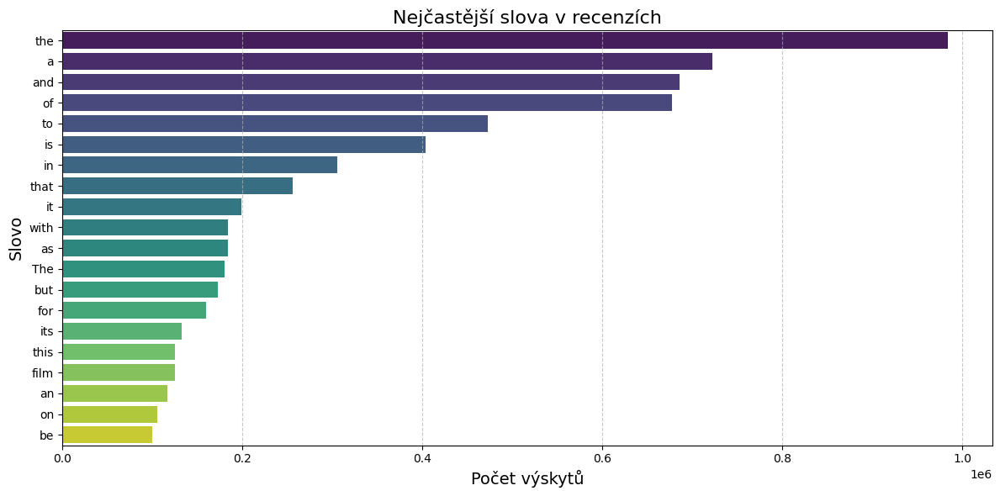

In [34]:
all_words = ' '.join(df['review_content'].dropna()).split()
most_common = Counter(all_words).most_common(20)
most_frequent_words = pd.DataFrame(most_common, columns=['word', 'count'])

plt.figure(figsize=(12, 6))
sns.barplot(x='count', y='word', data=most_frequent_words, hue='word', palette='viridis', legend=False)
plt.title(label='Nejčastější slova v recenzích', fontsize=16)
plt.xlabel('Počet výskytů', fontsize=14)
plt.ylabel('Slovo', fontsize=14)
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

#### Nejčastější slova v recenzích bez stop-slov

In [35]:
def clean_text(text):
	if not text:
		return ""
	
	text = re.sub(r'[^\w\s]', '', text.lower()) # převod na malá písmena a odstranění interpunkce
	text = re.sub(r'\d+', '', text) # odstranění čísel
	text = re.sub(r'\s+', ' ', text).strip() # odstranění nadbytečných mezer
	return text

In [36]:
def get_most_frequent_words(text_series, n=20):
	stop_words = set(stopwords.words('english'))
	
	all_texts = text_series.dropna().apply(clean_text)
	all_words = []
	for text in all_texts:
		words = [word for word in text.split() if word not in stop_words and len(word) > 2]
		all_words.extend(words)
	
	most_common = Counter(all_words).most_common(n)
	return pd.DataFrame(most_common, columns=['word', 'count'])

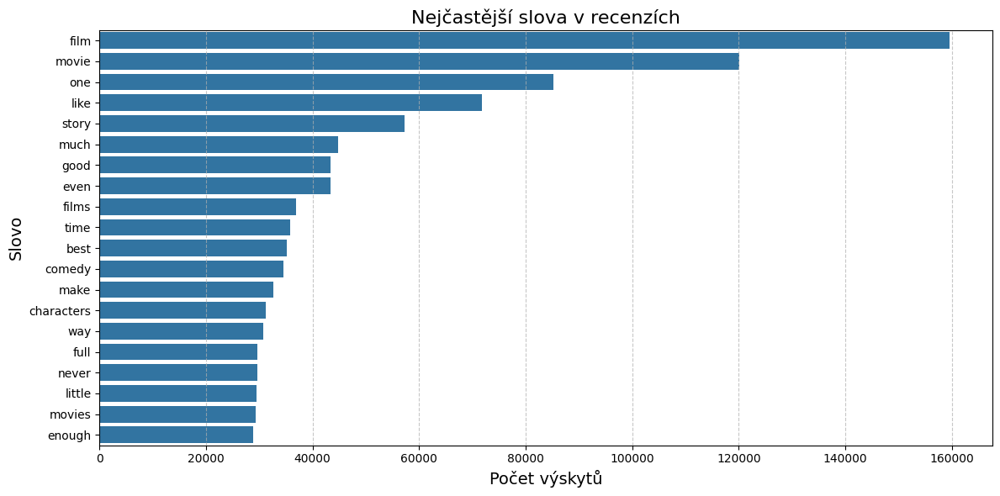

In [37]:
most_frequent_words = get_most_frequent_words(df['review_content'], n=20)

plt.figure(figsize=(12, 6))
sns.barplot(x='count', y='word', data=most_frequent_words)
plt.title('Nejčastější slova v recenzích', fontsize=16)
plt.xlabel('Počet výskytů', fontsize=14)
plt.ylabel('Slovo', fontsize=14)
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

##### Nejčastější slova v jednotlivých třídách

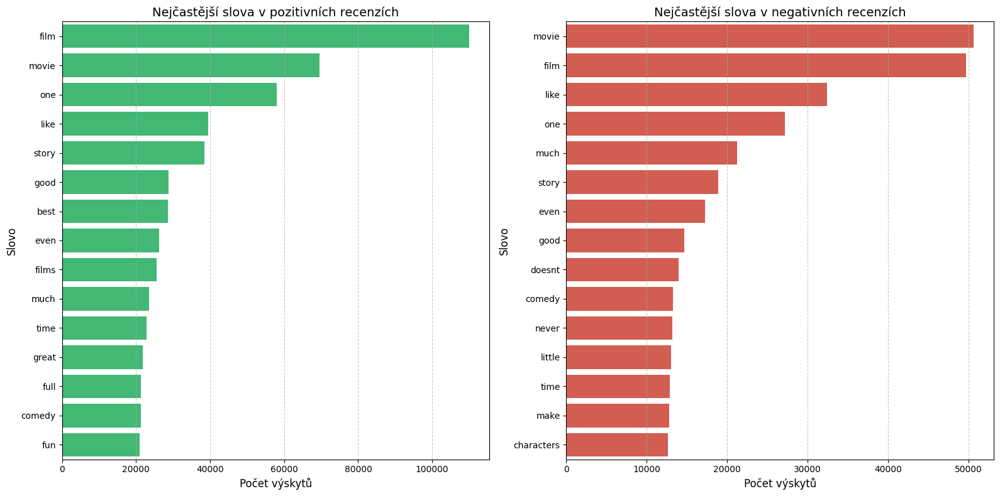

In [38]:
fresh_words = get_most_frequent_words(df[df['review_type'] == 'Fresh']['review_content'], n=15)
fresh_words['category'] = 'Fresh'

rotten_words = get_most_frequent_words(df[df['review_type'] == 'Rotten']['review_content'], n=15)
rotten_words['category'] = 'Rotten'

fig, axes = plt.subplots(1, 2, figsize=(16, 8))

sns.barplot(x='count', y='word', data=fresh_words, color='#2ecc71', ax=axes[0])
axes[0].set_title('Nejčastější slova v pozitivních recenzích', fontsize=14)
axes[0].set_xlabel('Počet výskytů', fontsize=12)
axes[0].set_ylabel('Slovo', fontsize=12)
axes[0].grid(axis='x', linestyle='--', alpha=0.7)

sns.barplot(x='count', y='word', data=rotten_words, color='#e74c3c', ax=axes[1])
axes[1].set_title('Nejčastější slova v negativních recenzích', fontsize=14)
axes[1].set_xlabel('Počet výskytů', fontsize=12)
axes[1].set_ylabel('Slovo', fontsize=12)
axes[1].grid(axis='x', linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()

### WordCloud

WordCloud je skvělý nástroj pro vizualizaci nejčastějších slov v recenzích ☁️.  
Vytvoříme WordCloud zvlášť pro pozitivní a negativní recenze, abychom viděli, jaká slova jsou nejvíce spojována s každým typem recenze 🔍.


In [39]:
def plot_wordcloud(text_series, title):
	stop_words = set(stopwords.words('english'))
	
	all_texts = text_series.dropna().apply(clean_text)

	filtered_texts = []
	for text in all_texts:
		words = [word for word in text.split() if word not in stop_words and len(word) > 2]
		filtered_texts.append(' '.join(words))
	
	all_words = ' '.join(filtered_texts)
	
	wordcloud = WordCloud(
		width=800,
		height=400,
		background_color='white',
		max_words=200
	).generate(all_words)
	
	plt.figure(figsize=(10, 5))
	plt.imshow(wordcloud, interpolation='bilinear')
	plt.axis('off')
	plt.title(title, fontsize=16)
	plt.tight_layout()
	plt.show()

#### Pozitivní recenze (Fresh)

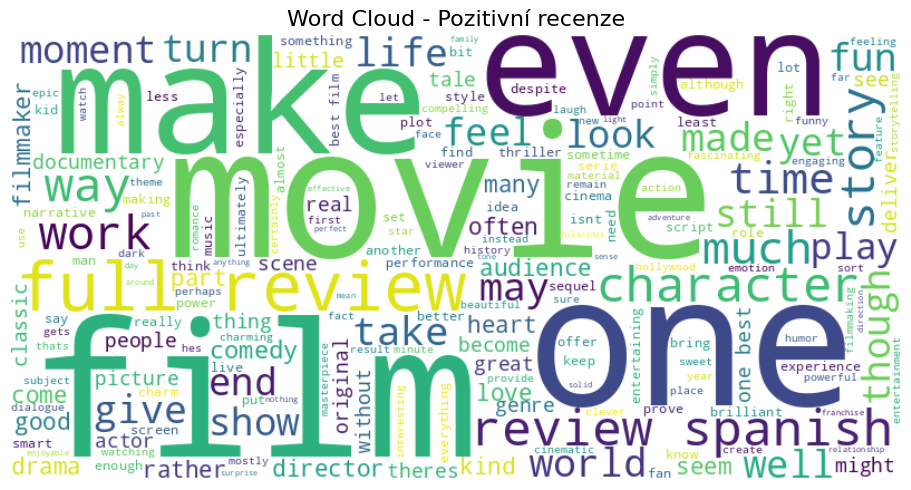

In [40]:
plot_wordcloud(df[df['review_type'] == 'Fresh']['review_content'], 'Word Cloud - Pozitivní recenze')

#### Negativní recenze (Rotten)

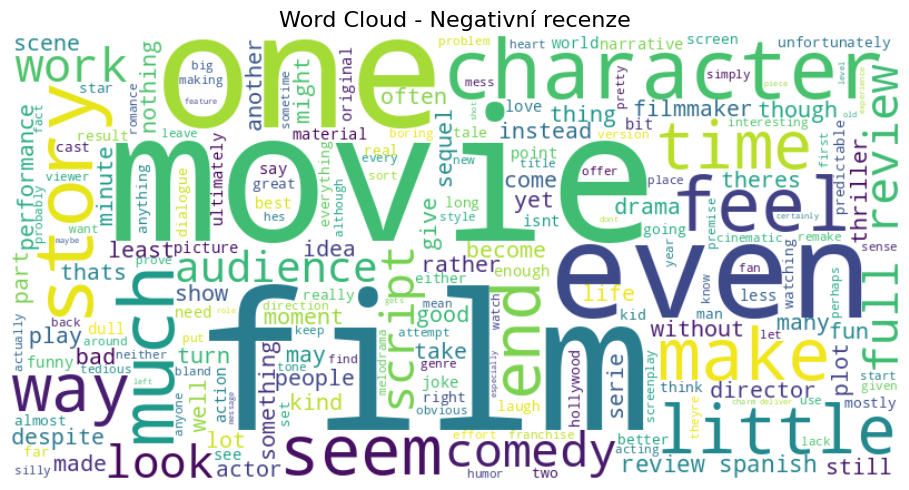

In [41]:
plot_wordcloud(df[df['review_type'] == 'Rotten']['review_content'], 'Word Cloud - Negativní recenze')

# Předzpracování dat

## Zahození nepotřebných sloupců

In [42]:
df = df.drop(columns=columns_to_drop)
df.columns

Index(['review_type', 'review_content'], dtype='object')

## Zahození chybějících hodnot

In [43]:
df.dropna(subset=['review_content'], inplace=True)

## Zahození krátkých recenzí

In [44]:
df = df[df['review_content'].str.len() > 2]

## Předzpracování textu

### Odstranění stop-slov

In [45]:
stop_words = set(stopwords.words('english'))

In [46]:
def remove_stop_words(text):
	if not text:
		return ""
	words = text.split()
	filtered_words = [word for word in words if word.lower() not in stop_words]
	return ' '.join(filtered_words)

In [47]:
df['review_content'] = df['review_content'].apply(remove_stop_words)

### Lemmatizace textu

In [48]:
def lemmatize_text(text):
    lemmatizer = WordNetLemmatizer()
    return ' '.join([lemmatizer.lemmatize(word) for word in text.split()])

In [49]:
df["review_content"] = df["review_content"].apply(lemmatize_text)

### Očištění textu od speciálních znaků  ✂️🔢

- odstraníme speciální znaky a čísla z textu, aby zůstal pouze čistý text 🧹
- převedeme text na malá písmena, aby se zjednodušila analýza a porovnávání slov  🔡
- odstraníme nadbytečné mezery, které mohou vzniknout při odstraňování speciálních znaků a čísel 🚀

In [50]:
def clean_text(text):
    text = re.sub(r'[^a-zA-Z\s]', '', text)  
    text = text.lower()  
    text = text.strip()
    return text

In [51]:
df['review_content'] = df['review_content'].apply(clean_text)

### Převedení cílové proměnné na číselné hodnoty

In [52]:
label_map = {'Fresh': 1, 'Rotten': 0}
df['label'] = df['review_type'].map(label_map)

In [53]:
df.head()

,review_type,review_content,label
0,Fresh,fantasy adventure fuse greek mythology contemp...,1
1,Fresh,uma thurman medusa gorgon coiffure writhing sn...,1
2,Fresh,topnotch cast dazzling special effects tide te...,1
3,Fresh,whether audience get behind lightning thief ha...,1
4,Rotten,whats really lacking lightning thief genuine s...,0


## Rozdělení dat na trénovací a testovací sadu

Jelikož máme až přebytek dat, zkusím vzít náhodný vzorek. Jelikož máme něco málo pod 300 tisíc Rotten recenzí po odstranění chybějících hodnot, zkusíme vzít 50 tisíc náhodných vzorků z obou tříd, abychom měli vybalancovaný dataset. To nám dá celkem 100 tisíc vzorků, což je stále dostatečné množství pro trénink modelu, což už je více než dostatečné množství pro trénink modelu.

In [54]:
def split_dataset(df, train_ratio=0.8, val_ratio=0.1, min_class_count=None):
	class_counts = df['review_type'].value_counts()
	if min_class_count is None:
		min_count = class_counts.min()
	else:
		min_count = min(min_class_count, class_counts.min())
	classes = class_counts.index.tolist()
	
	balanced_df = pd.concat([
		df[df['review_type'] == c].sample(n=min_count, random_state=SEED)
		for c in classes
	]).sample(frac=1, random_state=SEED).reset_index(drop=True)
	
	train_size = int(len(balanced_df) * train_ratio)
	val_size = int(len(balanced_df) * val_ratio)
	
	train_df = balanced_df[:train_size]
	val_df = balanced_df[train_size:train_size + val_size]
	test_df = balanced_df[train_size + val_size:]
	
	print("="*50)
	print(f"Počet tříd: {len(classes)}")
	print(f"Počet vzorků v každé třídě: {min_count:,}")
	print("-"*50)
	print(f"Tréninková sada: {len(train_df):,} vzorků")
	print(train_df['review_type'].value_counts().to_string())
	print("-"*50)
	print(f"Validační sada: {len(val_df):,} vzorků")
	print(val_df['review_type'].value_counts().to_string())
	print("-"*50)
	print(f"Testovací sada: {len(test_df):,} vzorků")
	print(test_df['review_type'].value_counts().to_string())
	print("-"*50)
	print(f"Celkem: {len(balanced_df):,} vzorků")
	print("="*50)
	
	return train_df, val_df, test_df

In [55]:
train_set, val_set, test_set = split_dataset(df, min_class_count=50_000)

Počet tříd: 2
Počet vzorků v každé třídě: 50,000
--------------------------------------------------
Tréninková sada: 80,000 vzorků
review_type
Rotten    40069
Fresh     39931
--------------------------------------------------
Validační sada: 10,000 vzorků
review_type
Rotten    5025
Fresh     4975
--------------------------------------------------
Testovací sada: 10,000 vzorků
review_type
Fresh     5094
Rotten    4906
--------------------------------------------------
Celkem: 100,000 vzorků


In [56]:
X_train = train_set['review_content'].values
y_train = train_set['label'].values

X_val = val_set['review_content'].values
y_val = val_set['label'].values

X_test = test_set['review_content'].values
y_test = test_set['label'].values

print(f"Tréninková sada: {len(X_train)} vzorků")
print(f"Validační sada: {len(X_val)} vzorků")
print(f"Testovací sada: {len(X_test)} vzorků")

Tréninková sada: 80000 vzorků
Validační sada: 10000 vzorků
Testovací sada: 10000 vzorků


## Zvolená metrika

Máme perfektně vybalancovaný dataset ⚖️, proto jako hlavní hodnotící metriku použijeme **přesnost** 🎯.  
Ta je vhodná, protože obě třídy jsou zastoupeny rovnoměrně a nehrozí zkreslení výsledků ve prospěch početnější třídy.


## Padding & Tokenizace

- **VOCAB_SIZE = 10_000**  
	Zachováme 10 000 nejčastějších slov pro tokenizaci, což je kompromis mezi informací a dostupnou pamětí

- **SEQ_LENGTH = 128**  
	Maximální délka sekvence nastavena na 128 tokenů. Delší texty budou oříznuty, kratší doplněny (padding).
	128 byl i medián délky textů, takže bychom se měli trfit do středu.


In [57]:
VOCAB_SIZE = 10_000    
SEQ_LENGTH = 128       

In [58]:
tokenizer = Tokenizer(num_words=VOCAB_SIZE)
tokenizer.fit_on_texts(X_train)

X_train_seq = tokenizer.texts_to_sequences(X_train)
X_test_seq = tokenizer.texts_to_sequences(X_test)
X_valid_seq = tokenizer.texts_to_sequences(X_val)

X_train_pad = pad_sequences(X_train_seq, maxlen=SEQ_LENGTH, padding='post')
X_test_pad = pad_sequences(X_test_seq, maxlen=SEQ_LENGTH, padding='post')
X_valid_pad = pad_sequences(X_valid_seq, maxlen=SEQ_LENGTH, padding='post')

X_train_pad = np.array(X_train_pad, dtype='int32')
y_train = np.array(y_train, dtype='float32')
X_val_pad = np.array(X_valid_pad, dtype='int32')
y_val = np.array(y_val, dtype='float32')

# Pomocné funkce pro trénování modelů

## Embedding

In [59]:
EMBEDING_DIM = 200

### Custom embedding

In [60]:
def in_emb_layers(words):
    input_layer = Input(shape=(1,), dtype=tf.string)

    vectorization = TextVectorization(max_tokens=VOCAB_SIZE,
                                      output_mode='int',
                                      output_sequence_length=SEQ_LENGTH)
    vectorization.adapt(words)
    vec = vectorization(input_layer)
    emb = Embedding(VOCAB_SIZE, EMBEDING_DIM)(vec)

    return input_layer, emb

### GloVe embedding

In [61]:
if not os.path.exists('data/glove/glove.6B.zip') and not os.path.exists('data/glove/glove.6B.50d.txt'):
    print("Downloading GloVe embeddings...")
    os.makedirs('data/glove', exist_ok=True)
    !wget http://nlp.stanford.edu/data/glove.6B.zip -P data/glove/
else:
    print("GloVe embedding už existují, přeskočím stahování.")

GloVe embedding už existují, přeskočím stahování.


In [62]:
if os.path.exists('data/glove/glove.6B.zip') and not os.path.exists('data/glove/glove.6B.50d.txt'):
    print("Extracting GloVe embeddings...")
    !unzip -q data/glove/glove.6B.zip -d data/glove/
else:
    print("GloVe embeddings již byly extrahovány, přeskočím extrakci.")

GloVe embeddings již byly extrahovány, přeskočím extrakci.


In [63]:
def glove_in_emb_tokenized(input_shape=(SEQ_LENGTH,)):
	path_to_glove_file = f'data/glove/glove.6B.{EMBEDING_DIM}d.txt'

	embeddings_index = {}
	with open(path_to_glove_file) as f:
		for line in f:
			word, coefs = line.split(maxsplit=1)
			coefs = np.fromstring(coefs, "f", sep=" ")
			embeddings_index[word] = coefs

	tokenizer = Tokenizer(num_words=VOCAB_SIZE)
	tokenizer.fit_on_texts(train_set['review_content'].values)
	word_index = tokenizer.word_index
	
	num_tokens = min(VOCAB_SIZE, len(word_index) + 1)
	embedding_matrix = np.zeros((num_tokens, EMBEDING_DIM))
	
	hits = 0
	misses = 0
	
	for word, i in word_index.items():
		if i >= VOCAB_SIZE:
			continue
		embedding_vector = embeddings_index.get(word)
		if embedding_vector is not None:
			embedding_matrix[i] = embedding_vector
			hits += 1
		else:
			misses += 1
	
	print(f"GloVe vektory: {hits} nalezeno a {misses} chybí")
	embed_init = Constant(embedding_matrix)
	
	input_layer = Input(shape=input_shape)
	
	emb = Embedding(
			num_tokens,
			EMBEDING_DIM,
			embeddings_initializer=embed_init,
			trainable=False)(input_layer)

	return input_layer, emb

## Vyhodnocení modelu

In [64]:
class_names = ['Fresh', 'Rotten']

In [65]:
def evaluate_model(model, X_test, y_test):
	y_pred_proba = model.predict(X_test)
	
	if len(y_pred_proba.shape) == 1 or y_pred_proba.shape[1] == 1:
		# převod sigmoid výstupů na binární predikce (0 nebo 1)
		y_pred = (y_pred_proba > 0.5).astype(int)
		if len(y_pred_proba.shape) > 1:
			y_pred = y_pred.flatten()
		
		y_true = y_test
	else:
		y_pred = np.argmax(y_pred_proba, axis=1)
		y_true = np.argmax(y_test, axis=1)
	
	report = classification_report(
		y_true, 
		y_pred, 
		target_names=class_names,
		zero_division=0
	)
	accuracy = accuracy_score(y_true, y_pred)

	print(f"Celková přesnost: {accuracy:.4f}")
	print("\nKlasifikační zpráva:")
	print(report)

	cm = confusion_matrix(y_true, y_pred)
	plt.figure(figsize=(10, 8))
	sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
				xticklabels=class_names,
				yticklabels=class_names)
	plt.xlabel('Predikováno')
	plt.ylabel('Skutečné')
	plt.title(f"Matice záměn (přesnost: {accuracy:.4f})")
	plt.xticks(rotation=45, ha='right')
	plt.tight_layout()
	plt.show()
	
	return accuracy, report

## Vizualizace trénovacího procesu

In [66]:
# you'll get tensorflow history, plot the loss and accuracy
def plot_training_history(history):
	plt.figure(figsize=(14, 5))
	
	plt.subplot(1, 2, 1)
	plt.plot(history.history['loss'], label='Tréninková ztráta')
	plt.plot(history.history['val_loss'], label='Validační ztráta')
	plt.title('Ztráta během trénování')
	plt.xlabel('Epochy')
	plt.ylabel('Ztráta')
	plt.legend()
	plt.grid()

	plt.subplot(1, 2, 2)
	plt.plot(history.history['accuracy'], label='Tréninková přesnost')
	plt.plot(history.history['val_accuracy'], label='Validační přesnost')
	plt.title('Přesnost během trénování')
	plt.xlabel('Epochy')
	plt.ylabel('Přesnost')
	plt.legend()
	plt.grid()

	plt.tight_layout()
	plt.show()

# Trénink modelů

## Parametry modelů

- **EPOCHS = 10** 🔁  
  Zvoleno jako výchozí počet iterací pro dostatečné učení bez výrazného rizika přeučení.  
  Při experimentech nižší hodnoty nestačily a vyšší už nepřinášely výrazné zlepšení.

- **BATCH_SIZE = 64** 📦  
  Vyvážená hodnota z hlediska výkonu a stability trénování.  
  Nižší velikosti zpomalovaly trénink, vyšší vedly ke zhoršení výsledků.

In [151]:
EPOCHS = 10
BATCH_SIZE = 64

### Vytvoření složky pro ukládání modelů

In [68]:
os.makedirs('models/third', exist_ok=True)

### Tensorboard 

In [69]:
tensorboard_log_dir = 'logs/fit/' + time.strftime("%Y%m%d-%H%M%S")
os.makedirs(tensorboard_log_dir, exist_ok=True)

In [70]:
tensorboard_callback = TensorBoard(
	log_dir=tensorboard_log_dir,
	histogram_freq=1,
	write_graph=True,
	write_images=True
)

## Model 1 - 🧠 LSTM základ

Tento model je navržen pro klasifikaci sentimentu recenzí pomocí neuronové sítě založené na LSTM (Long Short-Term Memory). Níže je popis jednotlivých vrstev a architektury modelu:

- **Vstup:** Sekvence délky `SEQ_LENGTH`  
- **Embedding:** Slovníkové vektory (velikost `VOCAB_SIZE`, dimenze `EMBEDING_DIM`)  
- **LSTM:** 128 jednotek, vrací celé sekvence  
- **Pooling:** Globální průměr přes časovou osu  
- **Dense:** 128 a 64 neuronů s ReLU + Dropout (0.5 a 0.3)  
- **Výstup:** 1 neuron, sigmoid (binární klasifikace)  
- **Optimalizace:** Adam, binary crossentropy  

💡 Jednoduchý LSTM s poolingem a dense vrstvami pro klasifikaci.


In [71]:
def create_model_1(input_shape=(SEQ_LENGTH,)):
	inputs = Input(shape=input_shape)
	
	x = Embedding(VOCAB_SIZE, EMBEDING_DIM)(inputs)
	
	x = LSTM(128, return_sequences=True)(x)
	
	x = GlobalAveragePooling1D()(x)
	
	x = Dense(128, activation='relu')(x)
	x = Dropout(0.5)(x)
	x = Dense(64, activation='relu')(x)
	x = Dropout(0.3)(x)
	
	outputs = Dense(1, activation='sigmoid')(x)
	
	model = Model(inputs=inputs, outputs=outputs)
	model.compile(
		optimizer='adam',
		loss='binary_crossentropy',
		metrics=['accuracy']
	)
	return model

In [72]:
model_1 = create_model_1(input_shape=(SEQ_LENGTH,))
model_1.summary()

I0000 00:00:1749859458.997237   13778 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 6096 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 2070, pci bus id: 0000:01:00.0, compute capability: 7.5


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ embedding (Embedding)           │ (None, 128, 200)       │     2,000,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm (LSTM)                     │ (None, 128, 128)       │       168,448 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling1d        │ (None, 128)            │             0 │
│ (GlobalAveragePooling1D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │        16,512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,193,281 (8.37 MB)

 Trainable params: 2,193,281 (8.37 MB)

 Non-trainable params: 0 (0.00 B)

In [73]:
start_time = time.time()
history_1 = model_1.fit(
	X_train_pad,
	y_train,
	validation_data=(X_valid_pad, y_val),
	epochs=EPOCHS,
	batch_size=BATCH_SIZE,
	callbacks=[
		ModelCheckpoint(
			filepath='models/third/model_1.h5', 
			monitor='val_accuracy',
			save_best_only=True,
		),
        tensorboard_callback
	],
)
train_time_1 = time.time() - start_time
print(f"Trénink modelu 1 trval {train_time_1:.2f} sekund.")

Epoch 1/10


I0000 00:00:1749859464.351841   14434 cuda_dnn.cc:529] Loaded cuDNN version 90501


1250/1250 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - accuracy: 0.5019 - loss: 0.6944

2025-06-14 02:05:01.693945: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


1250/1250 ━━━━━━━━━━━━━━━━━━━━ 43s 30ms/step - accuracy: 0.5019 - loss: 0.6944 - val_accuracy: 0.4975 - val_loss: 0.6976
Epoch 2/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 37s 29ms/step - accuracy: 0.5584 - loss: 0.6733 - val_accuracy: 0.7516 - val_loss: 0.5150
Epoch 3/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - accuracy: 0.7856 - loss: 0.4667 - val_accuracy: 0.7517 - val_loss: 0.5315
Epoch 4/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - accuracy: 0.8367 - loss: 0.3711 - val_accuracy: 0.7182 - val_loss: 0.6621
Epoch 5/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - accuracy: 0.8803 - loss: 0.2823 - val_accuracy: 0.7298 - val_loss: 0.6304
Epoch 6/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - accuracy: 0.9104 - loss: 0.2200 - val_accuracy: 0.7219 - val_loss: 0.7823
Epoch 7/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 38s 30ms/step - accuracy: 0.9284 - loss: 0.1785 - val_accuracy: 0.7193 - val_loss: 1.0156
Epoch 8/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 37s 30ms/step - accuracy: 0.9449 - loss: 0.14

2025-06-14 02:10:38.595589: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_14}}


 21/313 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step

313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
Celková přesnost: 0.7286

Klasifikační zpráva:
              precision    recall  f1-score   support

       Fresh       0.72      0.73      0.72      4906
      Rotten       0.74      0.73      0.73      5094

    accuracy                           0.73     10000
   macro avg       0.73      0.73      0.73     10000
weighted avg       0.73      0.73      0.73     10000



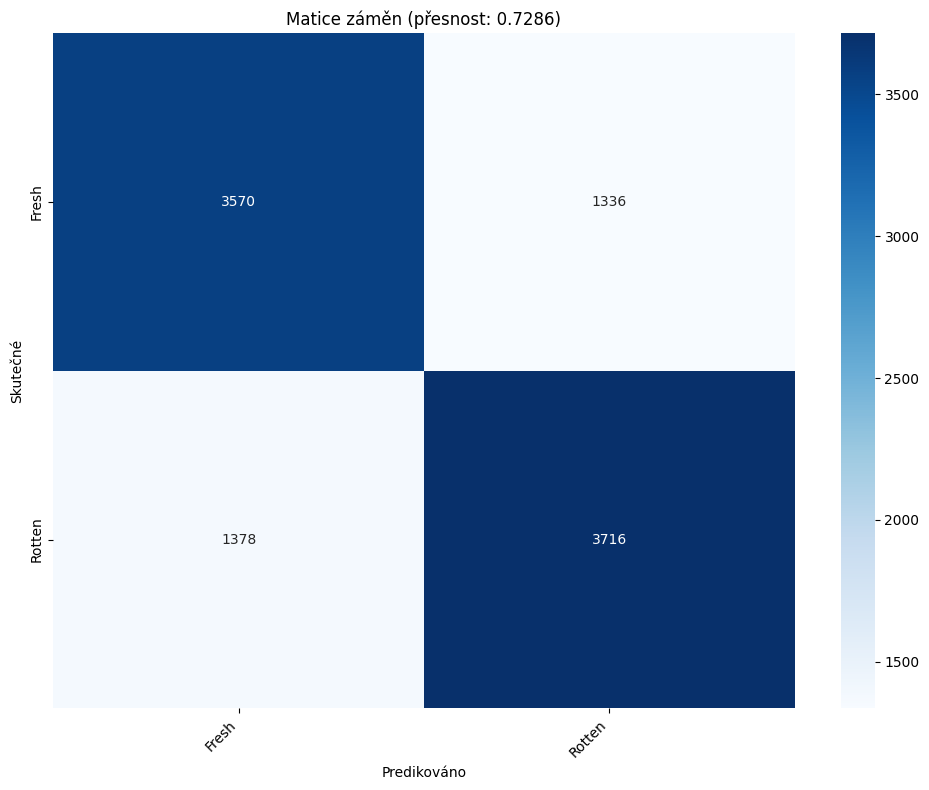

In [74]:
acc_1, report_1 = evaluate_model(model_1, X_test_pad, y_test)

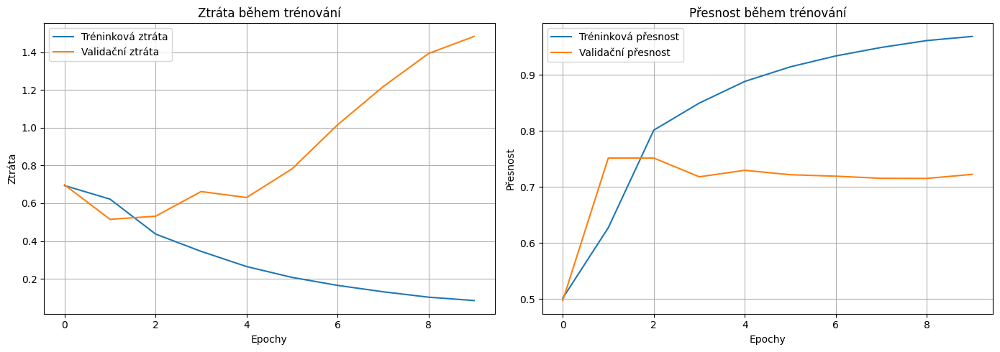

In [75]:
plot_training_history(history_1)

## Model 2 - GloVe embedding 🧠📝

Architektura tohoto modelu je stejná jako u předchozího modelu, jedinou změnou je použití předtrénovaných GloVe embeddingů 📚 v embedding vrstvě. Tyto embeddingy jsou inicializovány maticí GloVe a nejsou trénovatelné. 🔒


In [76]:
def create_model_2():
	inputs, x = glove_in_emb_tokenized()
	
	x = LSTM(128, return_sequences=True)(x)
	
	x = GlobalAveragePooling1D()(x)
	
	x = Dense(128, activation='relu')(x)
	x = Dropout(0.5)(x)
	x = Dense(64, activation='relu')(x)
	x = Dropout(0.3)(x)
	
	outputs = Dense(1, activation='sigmoid')(x)
	
	model = Model(inputs=inputs, outputs=outputs)
	model.compile(
		optimizer='adam',
		loss='binary_crossentropy',
		metrics=['accuracy']
	)
	return model

In [77]:
model_2 = create_model_2()
model_2.summary()

GloVe vektory: 9686 nalezeno a 313 chybí


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ embedding_1 (Embedding)         │ (None, 128, 200)       │     2,000,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_1 (LSTM)                   │ (None, 128, 128)       │       168,448 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling1d_1      │ (None, 128)            │             0 │
│ (GlobalAveragePooling1D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 128)            │        16,512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,193,281 (8.37 MB)

 Trainable params: 193,281 (755.00 KB)

 Non-trainable params: 2,000,000 (7.63 MB)

In [78]:
start_time = time.time()
history_2 = model_2.fit(
	X_train_pad,
	y_train,
	validation_data=(X_valid_pad, y_val),
	epochs=EPOCHS,
	batch_size=BATCH_SIZE,
	callbacks=[
		ModelCheckpoint(
			filepath='models/third/model_2.h5', 
			monitor='val_accuracy',
			save_best_only=True,
		),
        tensorboard_callback
	],
)
train_time_2 = time.time() - start_time
print(f"Trénink modelu 2 trval {train_time_2:.2f} sekund.")

Epoch 1/10
1249/1250 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - accuracy: 0.6802 - loss: 0.5934

2025-06-14 02:11:27.291874: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


1250/1250 ━━━━━━━━━━━━━━━━━━━━ 38s 28ms/step - accuracy: 0.6803 - loss: 0.5933 - val_accuracy: 0.7177 - val_loss: 0.5388
Epoch 2/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 33s 27ms/step - accuracy: 0.7508 - loss: 0.5087 - val_accuracy: 0.7487 - val_loss: 0.5088
Epoch 3/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 33s 27ms/step - accuracy: 0.7748 - loss: 0.4738 - val_accuracy: 0.7540 - val_loss: 0.5007
Epoch 4/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 31s 25ms/step - accuracy: 0.7956 - loss: 0.4422 - val_accuracy: 0.7477 - val_loss: 0.5100
Epoch 5/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 31s 25ms/step - accuracy: 0.8165 - loss: 0.4074 - val_accuracy: 0.7508 - val_loss: 0.5199
Epoch 6/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 30s 24ms/step - accuracy: 0.8400 - loss: 0.3727 - val_accuracy: 0.7471 - val_loss: 0.5450
Epoch 7/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 31s 25ms/step - accuracy: 0.8584 - loss: 0.3364 - val_accuracy: 0.7406 - val_loss: 0.5672
Epoch 8/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 31s 25ms/step - accuracy: 0.8755 - loss: 0.30

2025-06-14 02:16:17.340483: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_14}}


313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
Celková přesnost: 0.7338

Klasifikační zpráva:
              precision    recall  f1-score   support

       Fresh       0.79      0.62      0.70      4906
      Rotten       0.70      0.84      0.76      5094

    accuracy                           0.73     10000
   macro avg       0.75      0.73      0.73     10000
weighted avg       0.74      0.73      0.73     10000



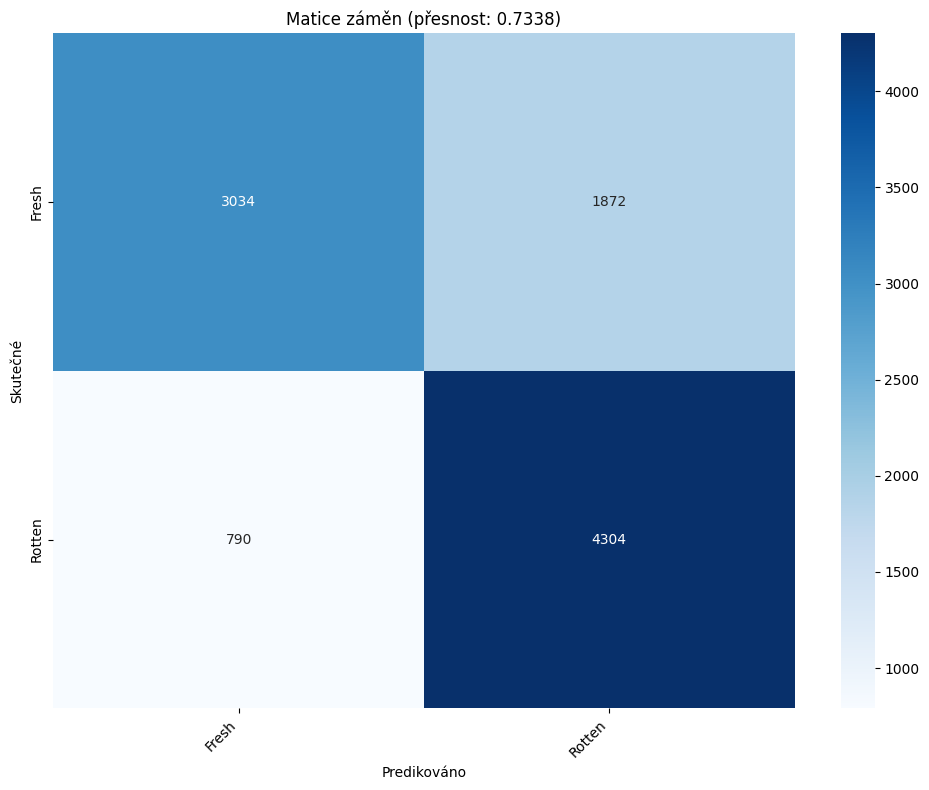

In [79]:
acc_2, report_2 = evaluate_model(model_2, X_test_pad, y_test)

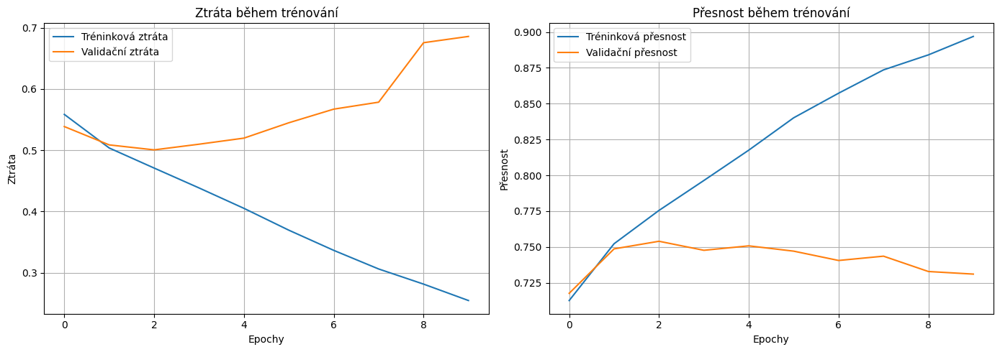

In [80]:
plot_training_history(history_2)

In [81]:
print(f"Model 1 - doba trénování: {train_time_1:.2f} sekund, Přesnost: {acc_1:.4f}")
print(f"Model 2 - doba trénování: {train_time_2:.2f} sekund, Přesnost: {acc_2:.4f}")

Model 1 - doba trénování: 377.84 sekund, Přesnost: 0.7286
Model 2 - doba trénování: 324.73 sekund, Přesnost: 0.7338


### Porovnání modelů

První model využíval **custom embedding**, zatímco druhý model používal **GloVe embedding**. Na základě výsledků je druhý model přesnější (přesnost: **73.38 %**) než první model (přesnost: **72.86 %**). Proto se rozhodneme pokračovat s modelem využívajícím **GloVe embedding**. I čas trénování byl u druhého modelu kratší, což je další výhoda.

## Tensorboard

Pro použití odkomentovat.

In [82]:
# %load_ext tensorboard
# %tensorboard --logdir logs

## Model 3 - ⚡️ Vylepšený LSTM s GloVe a větší hloubkou

- **Vstup:** `glove_in_emb_tokenized()` (GloVe embedding, tokenizace)  
- **LSTM:** 256 jednotek (víc než model 1), return_sequences=True  
- **Dropout:** po LSTM 0.3  
- **Pooling:** Globální průměr  
- **Dense vrstvy:** 256 → 192 → 128 → 64 neuronů s ReLU a vysokým dropout (0.5, 0.4, 0.4, 0.3)  
- **Výstup:** 1 neuron, sigmoid  
- **Optimalizace:** Adam, binary crossentropy  

➕ **Novinky oproti modelu 1 a 2:**  
- GloVe embedding místo jednoduchého embeddingu  
- Větší LSTM (256 vs 128)  
- Více dense vrstev a neuronů  
- Více dropout vrstev a vyšší míra regularizace  
- Komplexnější architektura pro lepší generalizaci  


In [83]:
def create_model_3():
	inputs, x = glove_in_emb_tokenized()

	x = LSTM(256, return_sequences=True)(x)
	x = Dropout(0.3)(x)
	
	x = GlobalAveragePooling1D()(x)
	
	x = Dense(256, activation='relu')(x)
	x = Dropout(0.5)(x)
	
	x = Dense(192, activation='relu')(x)
	x = Dropout(0.4)(x)
	
	x = Dense(128, activation='relu')(x)
	x = Dropout(0.4)(x)
	
	x = Dense(64, activation='relu')(x)
	x = Dropout(0.3)(x)
	
	outputs = Dense(1, activation='sigmoid')(x)
	
	model = Model(inputs=inputs, outputs=outputs)
	model.compile(
		optimizer='adam',
		loss='binary_crossentropy',
		metrics=['accuracy']
	)
	return model


In [152]:
model_3 = create_model_3()
model_3.summary()

GloVe vektory: 9686 nalezeno a 313 chybí


Model: "functional_30"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_30 (InputLayer)     │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ embedding_30 (Embedding)        │ (None, 128, 200)       │     2,000,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_31 (LSTM)                  │ (None, 128, 256)       │       467,968 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_103 (Dropout)           │ (None, 128, 256)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling1d_7      │ (None, 256)            │             0 │
│ (GlobalAveragePooling1D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_127 (Dense)               │ (None, 256)            │        65,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_104 (Dropout)           │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_128 (Dense)               │ (None, 192)            │        49,344 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_105 (Dropout)           │ (None, 192)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_129 (Dense)               │ (None, 128)            │        24,704 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_106 (Dropout)           │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_130 (Dense)               │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_107 (Dropout)           │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_131 (Dense)               │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,616,129 (9.98 MB)

 Trainable params: 616,129 (2.35 MB)

 Non-trainable params: 2,000,000 (7.63 MB)

In [153]:
start_time = time.time()
history_3 = model_3.fit(
	X_train_pad,
	y_train,
	validation_data=(X_valid_pad, y_val),
	epochs=EPOCHS,
	batch_size=BATCH_SIZE,
	callbacks=[
		ModelCheckpoint(
			filepath='models/third/model_3.h5', 
			monitor='val_accuracy',
			save_best_only=True,
		),
		tensorboard_callback
	],
)
train_time_3 = time.time() - start_time
print(f"Trénink modelu 3 trval {train_time_3:.2f} sekund.")

Epoch 1/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step - accuracy: 0.6605 - loss: 0.6008

2025-06-14 08:32:19.634584: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


1250/1250 ━━━━━━━━━━━━━━━━━━━━ 69s 51ms/step - accuracy: 0.6606 - loss: 0.6007 - val_accuracy: 0.7396 - val_loss: 0.5224
Epoch 2/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 63s 50ms/step - accuracy: 0.7515 - loss: 0.5098 - val_accuracy: 0.7426 - val_loss: 0.5182
Epoch 3/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 68s 55ms/step - accuracy: 0.7758 - loss: 0.4760 - val_accuracy: 0.7489 - val_loss: 0.5186
Epoch 4/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 65s 52ms/step - accuracy: 0.8000 - loss: 0.4369 - val_accuracy: 0.7467 - val_loss: 0.5308
Epoch 5/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 56s 45ms/step - accuracy: 0.8241 - loss: 0.3935 - val_accuracy: 0.7475 - val_loss: 0.5725
Epoch 6/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 67s 53ms/step - accuracy: 0.8513 - loss: 0.3404 - val_accuracy: 0.7459 - val_loss: 0.5820
Epoch 7/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 65s 52ms/step - accuracy: 0.8768 - loss: 0.2900 - val_accuracy: 0.7431 - val_loss: 0.6991
Epoch 8/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 62s 49ms/step - accuracy: 0.8965 - loss: 0.24

2025-06-14 08:41:49.200681: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_14}}


313/313 ━━━━━━━━━━━━━━━━━━━━ 4s 12ms/step
Celková přesnost: 0.7390

Klasifikační zpráva:
              precision    recall  f1-score   support

       Fresh       0.77      0.67      0.72      4906
      Rotten       0.72      0.80      0.76      5094

    accuracy                           0.74     10000
   macro avg       0.74      0.74      0.74     10000
weighted avg       0.74      0.74      0.74     10000



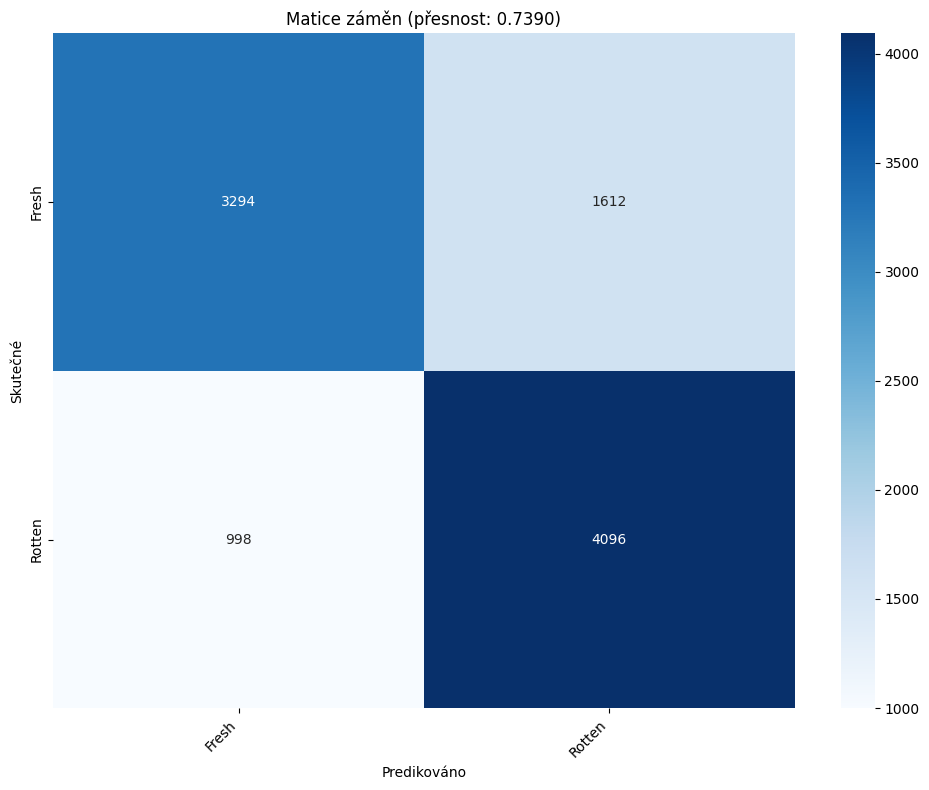

In [154]:
acc_3, report_3 = evaluate_model(model_3, X_test_pad, y_test)

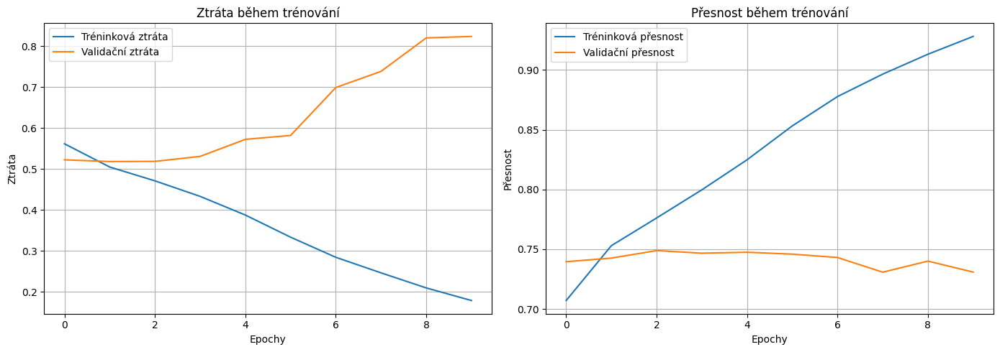

In [155]:
plot_training_history(history_3)

In [156]:
print(f"Přesnost modelu 2: {acc_2:.4f}")
print(f"Přesnost modelu 3: {acc_3:.4f}")

Přesnost modelu 2: 0.7338
Přesnost modelu 3: 0.7390


Parádá! Dosáhli jsme vyšší přesnosti s novým modelem, který má více vrstev. Zkusíme pokračovat v stejném duchu a přidat další vrstvy do modelu.

## Model 4 - 🚀 Hloubka + BatchNorm + větší kapacita

- **Vstup:** GloVe embedding + tokenizace  
- **LSTM:** 384 jednotek (víc než model 3), return_sequences=True  
- **Dropout:** 0.3 po LSTM  
- **Pooling:** Globální průměr  
- **Dense:** 512 → 384 → 256 → 192 → 128 → 64 neuronů, všechny s ReLU  
- **BatchNormalization:** po každé dense vrstvě  
- **Dropout:** postupně 0.5, 0.5, 0.4, 0.4, 0.3, 0.2  
- **Výstup:** 1 neuron, sigmoid  
- **Optimalizace:** Adam, binary crossentropy  

➕ **Novinky oproti modelu 3:**  
- Výrazně větší LSTM (384 vs 256)  
- Přidání BatchNormalization pro stabilnější trénink  
- Více dense vrstev s většími počty neuronů (až 512)  
- Jemnější dropout scheduling (nižší dropout v pozdějších vrstvách)  


In [89]:
def create_model_4():
	inputs, x = glove_in_emb_tokenized()
	
	x = LSTM(384, return_sequences=True)(x)
	x = Dropout(0.3)(x)
	
	x = GlobalAveragePooling1D()(x)
	
	x = Dense(512, activation='relu')(x)
	x = BatchNormalization()(x)
	x = Dropout(0.5)(x)
	
	x = Dense(384, activation='relu')(x)
	x = BatchNormalization()(x)
	x = Dropout(0.5)(x)
	
	x = Dense(256, activation='relu')(x)
	x = BatchNormalization()(x)
	x = Dropout(0.4)(x)
	
	x = Dense(192, activation='relu')(x)
	x = BatchNormalization()(x)
	x = Dropout(0.4)(x)
	
	x = Dense(128, activation='relu')(x)
	x = BatchNormalization()(x)
	x = Dropout(0.3)(x)
	
	x = Dense(64, activation='relu')(x)
	x = BatchNormalization()(x)
	x = Dropout(0.2)(x)
	
	outputs = Dense(1, activation='sigmoid')(x)
	
	model = Model(inputs=inputs, outputs=outputs)
	model.compile(
		optimizer='adam',
		loss='binary_crossentropy',
		metrics=['accuracy']
	)
	return model


In [90]:
model_4 = create_model_4()
model_4.summary()

GloVe vektory: 9686 nalezeno a 313 chybí


Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_3 (InputLayer)      │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ embedding_3 (Embedding)         │ (None, 128, 200)       │     2,000,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_3 (LSTM)                   │ (None, 128, 384)       │       898,560 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_9 (Dropout)             │ (None, 128, 384)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling1d_3      │ (None, 384)            │             0 │
│ (GlobalAveragePooling1D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_11 (Dense)                │ (None, 512)            │       197,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 512)            │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_10 (Dropout)            │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_12 (Dense)                │ (None, 384)            │       196,992 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 384)            │         1,536 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_11 (Dropout)            │ (None, 384)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_13 (Dense)                │ (None, 256)            │        98,560 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 256)            │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_12 (Dropout)            │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_14 (Dense)                │ (None, 192)            │        49,344 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 192)            │           768 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_13 (Dropout)            │ (None, 192)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_15 (Dense)                │ (None, 128)            │        24,704 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 128)            │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_14 (Dropout)            │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_16 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 64)             │           25

 Total params: 3,479,745 (13.27 MB)

 Trainable params: 1,476,673 (5.63 MB)

 Non-trainable params: 2,003,072 (7.64 MB)

In [91]:
start_time = time.time()
history_4 = model_4.fit(
	X_train_pad,
	y_train,
	validation_data=(X_valid_pad, y_val),
	epochs=EPOCHS,
	batch_size=BATCH_SIZE,
	callbacks=[
		ModelCheckpoint(
			filepath='models/third/model_4.h5', 
			monitor='val_accuracy',
			save_best_only=True,
		),
		tensorboard_callback
	],
)
train_time_4 = time.time() - start_time
print(f"Trénink modelu 4 trval {train_time_4:.2f} sekund.")

Epoch 1/10
1249/1250 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step - accuracy: 0.5621 - loss: 0.7345

2025-06-14 02:24:47.067278: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


1250/1250 ━━━━━━━━━━━━━━━━━━━━ 79s 57ms/step - accuracy: 0.5622 - loss: 0.7343 - val_accuracy: 0.6088 - val_loss: 0.6712
Epoch 2/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 69s 55ms/step - accuracy: 0.7283 - loss: 0.5392 - val_accuracy: 0.5047 - val_loss: 1.7006
Epoch 3/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 71s 57ms/step - accuracy: 0.7423 - loss: 0.5146 - val_accuracy: 0.6995 - val_loss: 0.5760
Epoch 4/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 68s 54ms/step - accuracy: 0.7600 - loss: 0.4915 - val_accuracy: 0.6327 - val_loss: 0.7217
Epoch 5/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 73s 58ms/step - accuracy: 0.7762 - loss: 0.4668 - val_accuracy: 0.7419 - val_loss: 0.5340
Epoch 6/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 73s 58ms/step - accuracy: 0.7933 - loss: 0.4373 - val_accuracy: 0.7428 - val_loss: 0.5444
Epoch 7/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 69s 55ms/step - accuracy: 0.8133 - loss: 0.4063 - val_accuracy: 0.7204 - val_loss: 0.6074
Epoch 8/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 68s 55ms/step - accuracy: 0.8430 - loss: 0.35

2025-06-14 02:35:24.972643: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_14}}


313/313 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step
Celková přesnost: 0.6959

Klasifikační zpráva:
              precision    recall  f1-score   support

       Fresh       0.63      0.90      0.74      4906
      Rotten       0.84      0.50      0.63      5094

    accuracy                           0.70     10000
   macro avg       0.74      0.70      0.68     10000
weighted avg       0.74      0.70      0.68     10000



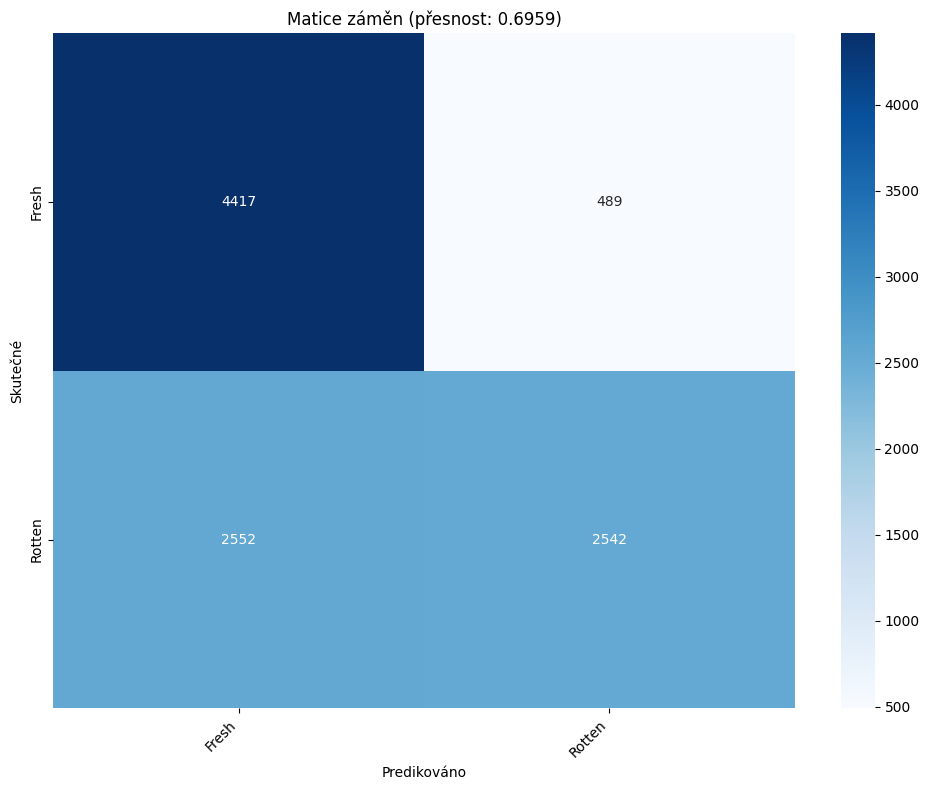

In [92]:
acc_4, report_4 = evaluate_model(model_4, X_test_pad, y_test)

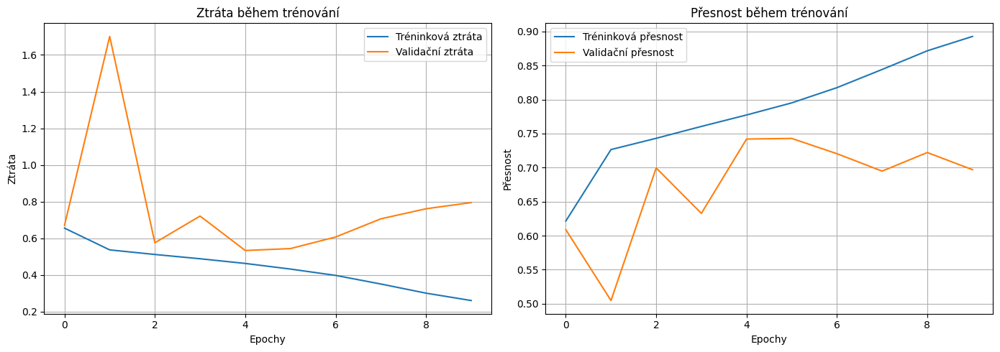

In [93]:
plot_training_history(history_4)

In [157]:
print(f"Přesnost modelu 3: {acc_3:.4f}")
print(f"Přesnost modelu 4: {acc_4:.4f}")

Přesnost modelu 3: 0.7390
Přesnost modelu 4: 0.6959


Přidání jetště více vrstev vedlo k horšímu výsledku, což je překvapivé. Pro další experimenty použijeme model 3.

## Model 5 - 🔄 Bidirectional LSTM dvouvrstvý

- **Vstup:** GloVe embedding + tokenizace  
- **LSTM:** 2x Bidirectional LSTM po 128 jednotkách, return_sequences=True  
- **Dropout:** 0.3 po každém BiLSTM  
- **Pooling:** Globální průměr  
- **Dense:** 256 → 192 → 128 → 64 neuronů s ReLU a dropout (0.5, 0.4, 0.4, 0.3)  
- **Výstup:** 1 neuron, sigmoid  
- **Optimalizace:** Adam, binary crossentropy  

➕ **Novinky oproti modelu 4:**  
- Použití **bidirectional LSTM** (dvojí směr čtení sekvence)  
- Dvě vrstvy LSTM místo jedné, každá s 128 jednotkami (menší počet než u modelu 4, ale dvě vrstvy)  
- Bez BatchNormalization  
- Stále silná regularizace Dropoutem  

In [95]:
def create_model_5():
	inputs, x = glove_in_emb_tokenized()
	
	x = Bidirectional(LSTM(128, return_sequences=True))(x)
	x = Dropout(0.3)(x)
	
	x = Bidirectional(LSTM(128, return_sequences=True))(x)
	x = Dropout(0.3)(x)
	
	x = GlobalAveragePooling1D()(x)
	
	x = Dense(256, activation='relu')(x)
	x = Dropout(0.5)(x)
	
	x = Dense(192, activation='relu')(x)
	x = Dropout(0.4)(x)
	
	x = Dense(128, activation='relu')(x)
	x = Dropout(0.4)(x)
	
	x = Dense(64, activation='relu')(x)
	x = Dropout(0.3)(x)
	
	outputs = Dense(1, activation='sigmoid')(x)
	
	model = Model(inputs=inputs, outputs=outputs)
	model.compile(
		optimizer='adam',
		loss='binary_crossentropy',
		metrics=['accuracy']
	)
	return model


In [158]:
model_5 = create_model_5()
model_5.summary()

GloVe vektory: 9686 nalezeno a 313 chybí


Model: "functional_31"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_31 (InputLayer)     │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ embedding_31 (Embedding)        │ (None, 128, 200)       │     2,000,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_24                │ (None, 128, 256)       │       336,896 │
│ (Bidirectional)                 │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_108 (Dropout)           │ (None, 128, 256)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_25                │ (None, 128, 256)       │       394,240 │
│ (Bidirectional)                 │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_109 (Dropout)           │ (None, 128, 256)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling1d_8      │ (None, 256)            │             0 │
│ (GlobalAveragePooling1D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_132 (Dense)               │ (None, 256)            │        65,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_110 (Dropout)           │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_133 (Dense)               │ (None, 192)            │        49,344 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_111 (Dropout)           │ (None, 192)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_134 (Dense)               │ (None, 128)            │        24,704 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_112 (Dropout)           │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_135 (Dense)               │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_113 (Dropout)           │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_136 (Dense)               │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,879,297 (10.98 MB)

 Trainable params: 879,297 (3.35 MB)

 Non-trainable params: 2,000,000 (7.63 MB)

In [159]:
start_time = time.time()
history_5 = model_5.fit(
	X_train_pad,
	y_train,
	validation_data=(X_valid_pad, y_val),
	epochs=EPOCHS,
	batch_size=BATCH_SIZE,
	callbacks=[
		ModelCheckpoint(
			filepath='models/third/model_5.h5', 
			monitor='val_accuracy',
			save_best_only=True,
		),
		tensorboard_callback
	],
)
train_time_5 = time.time() - start_time
print(f"Trénink modelu 5 trval {train_time_5:.2f} sekund.")

Epoch 1/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step - accuracy: 0.6506 - loss: 0.6095

2025-06-14 08:45:09.199726: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


1250/1250 ━━━━━━━━━━━━━━━━━━━━ 136s 100ms/step - accuracy: 0.6507 - loss: 0.6094 - val_accuracy: 0.7300 - val_loss: 0.5313
Epoch 2/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 123s 99ms/step - accuracy: 0.7506 - loss: 0.5115 - val_accuracy: 0.7404 - val_loss: 0.5170
Epoch 3/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 119s 95ms/step - accuracy: 0.7751 - loss: 0.4732 - val_accuracy: 0.7482 - val_loss: 0.5093
Epoch 4/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 77s 61ms/step - accuracy: 0.7976 - loss: 0.4361 - val_accuracy: 0.7570 - val_loss: 0.5131
Epoch 5/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 117s 93ms/step - accuracy: 0.8217 - loss: 0.3956 - val_accuracy: 0.7517 - val_loss: 0.5448
Epoch 6/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 117s 94ms/step - accuracy: 0.8463 - loss: 0.3524 - val_accuracy: 0.7468 - val_loss: 0.6496
Epoch 7/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 113s 90ms/step - accuracy: 0.8667 - loss: 0.3119 - val_accuracy: 0.7430 - val_loss: 0.6057
Epoch 8/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 123s 98ms/step - accuracy: 0.8874 - lo

2025-06-14 09:01:30.376488: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_14}}


313/313 ━━━━━━━━━━━━━━━━━━━━ 9s 26ms/step
Celková přesnost: 0.7427

Klasifikační zpráva:
              precision    recall  f1-score   support

       Fresh       0.78      0.67      0.72      4906
      Rotten       0.72      0.81      0.76      5094

    accuracy                           0.74     10000
   macro avg       0.75      0.74      0.74     10000
weighted avg       0.75      0.74      0.74     10000



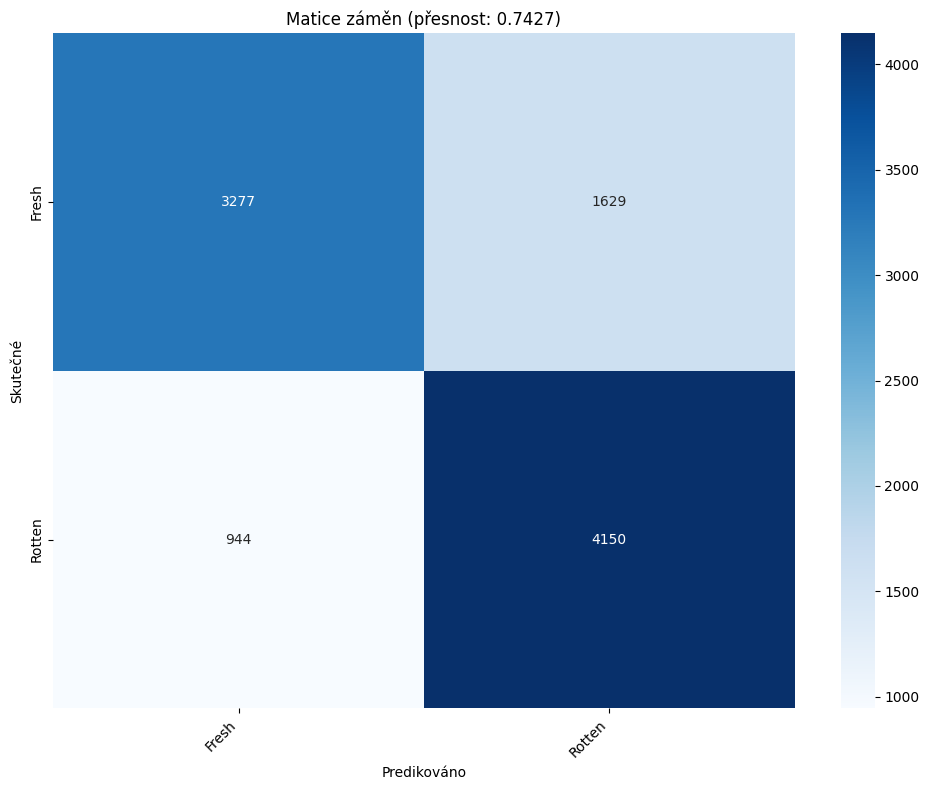

In [160]:
acc_5, report_5 = evaluate_model(model_5, X_test_pad, y_test)

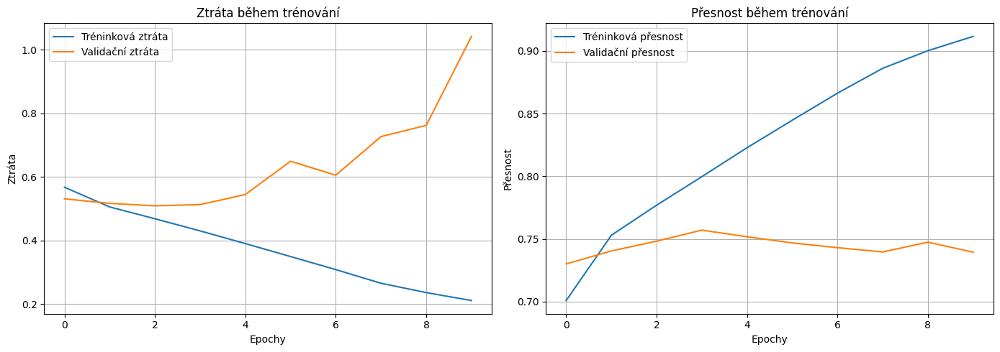

In [161]:
plot_training_history(history_5)

In [162]:
print(f"Přesnost modelu 3: {acc_3:.4f}")
print(f"Přesnost modelu 5: {acc_5:.4f}")

Přesnost modelu 3: 0.7390
Přesnost modelu 5: 0.7427


Model 5 dosáhl nejvyšší přesnosti a bude nejlepší volbou pro další experimenty. Naopak model 3, který obsahoval méně vrstev, dosáhl nižší přesnosti. Proto se rozhodneme pokračovat s modelem 5, který nabízí optimální rovnováhu mezi složitostí a výkonem.

Poznámka: Musel jsem to restartovat, protože server spadnul. Na první pokus měl model 3 vyšší  přesnost, a proto jsem iteroval další modely na architektuře modelu 3. Na druhý pokus jsem ale dosáhl vyšší přesnosti s modelem 5, který je tedy lepším modelem. 

## Model 6 - 🎯 LSTM + Attention

- **Vstup:** GloVe embedding + tokenizace  
- **LSTM:** 256 jednotek, return_sequences=True  
- **Dropout:** 0.3 po LSTM  
- **Attention:**  
  - Dense + tanh → softmax váhy přes časovou osu  
  - Váhované součty (attention weighting) místo globálního průměru  
- **Dense:** 256 → 192 → 128 → 64 neuronů s ReLU a dropout (0.5, 0.4, 0.4, 0.3)  
- **Výstup:** 1 neuron, sigmoid  
- **Optimalizace:** Adam, binary crossentropy  

➕ **Novinky oproti modelu 5:**  
- Přidání **attention mechanismu** pro lepší zaměření na důležité časové kroky  
- Attention nahrazuje globální pooling (váhovaný součet místo průměru)  
- Jednovrstvý LSTM (256) místo dvouvrstvého bidirectional  

In [101]:
def create_model_6():
	inputs, x = glove_in_emb_tokenized()

	x = LSTM(256, return_sequences=True)(x)
	x = Dropout(0.3)(x)

	attention = Dense(1, activation='tanh')(x)
	attention = Flatten()(attention)
	attention = Activation('softmax')(attention)
	attention = RepeatVector(256)(attention)
	attention = Permute([2, 1])(attention)
	x = Multiply()([x, attention])
	x = Lambda(lambda z: K.sum(z, axis=1), output_shape=(256,))(x)  # Summing over the time steps

	x = Dense(256, activation='relu')(x)
	x = Dropout(0.5)(x)

	x = Dense(192, activation='relu')(x)
	x = Dropout(0.4)(x)

	x = Dense(128, activation='relu')(x)
	x = Dropout(0.4)(x)

	x = Dense(64, activation='relu')(x)
	x = Dropout(0.3)(x)

	outputs = Dense(1, activation='sigmoid')(x)

	model = Model(inputs=inputs, outputs=outputs)
	model.compile(
		optimizer='adam',
		loss='binary_crossentropy',
		metrics=['accuracy']
	)
	return model


In [102]:
model_6 = create_model_6()
model_6.summary()

GloVe vektory: 9686 nalezeno a 313 chybí


Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_5       │ (None, 128)       │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding_5         │ (None, 128, 200)  │  2,000,000 │ input_layer_5[0]… │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lstm_6 (LSTM)       │ (None, 128, 256)  │    467,968 │ embedding_5[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_22          │ (None, 128, 256)  │          0 │ lstm_6[0][0]      │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_23 (Dense)    │ (None, 128, 1)    │        257 │ dropout_22[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ flatten (Flatten)   │ (None, 128)       │          0 │ dense_23[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation          │ (None, 128)       │          0 │ flatten[0][0]     │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ repeat_vector       │ (None, 256, 128)  │          0 │ activation[0][0]  │
│ (RepeatVector)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ permute (Permute)   │ (None, 128, 256)  │          0 │ repeat_vector[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ multiply (Multiply) │ (None, 128, 256)  │          0 │ dropout_22[0][0], │
│                     │                   │            │ permute[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lambda (Lambda)     │ (None, 256)       │          0 │ multiply[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_24 (Dense)    │ (None, 256)       │     65,792 │ lambda[0][0]      │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_23          │ (None, 256)       │          0 │ dense_24[0][0]    │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_25 (Dense)    │ (None, 192)       │     49,344 │ dropout_23[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_24          │ (None, 192)       │          0 │ dense_25[0][0]    │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_26 (Dense)    │ (None, 128)       │     24,704 │ dropout_24[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_25          │ (None, 128)       │          0 │ dense_26[0][0]    │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_27 (Dense)    │ (None, 64)        │      8,256 │ dropout_25[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_26          │ (None, 64)        │          0 │ dense_27[0][0]    │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_28 (Dense)    │ (None, 1)         │         65 │ dropout_26[0][0]

 Total params: 2,616,386 (9.98 MB)

 Trainable params: 616,386 (2.35 MB)

 Non-trainable params: 2,000,000 (7.63 MB)

In [103]:
start_time = time.time()
history_6 = model_6.fit(
	X_train_pad,
	y_train,
	validation_data=(X_valid_pad, y_val),
	epochs=EPOCHS,
	batch_size=BATCH_SIZE,
	callbacks=[
		ModelCheckpoint(
			filepath='models/third/model_6.h5', 
			monitor='val_accuracy',
			save_best_only=True,
		),
		tensorboard_callback
	],
)
train_time_6 = time.time() - start_time
print(f"Trénink modelu 6 trval {train_time_6:.2f} sekund.")

Epoch 1/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - accuracy: 0.6595 - loss: 0.6082

2025-06-14 02:48:37.924925: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


1250/1250 ━━━━━━━━━━━━━━━━━━━━ 50s 37ms/step - accuracy: 0.6595 - loss: 0.6082 - val_accuracy: 0.7330 - val_loss: 0.5270
Epoch 2/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 46s 37ms/step - accuracy: 0.7515 - loss: 0.5097 - val_accuracy: 0.7518 - val_loss: 0.5053
Epoch 3/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 45s 36ms/step - accuracy: 0.7752 - loss: 0.4738 - val_accuracy: 0.7600 - val_loss: 0.4920
Epoch 4/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - accuracy: 0.7988 - loss: 0.4391 - val_accuracy: 0.7556 - val_loss: 0.5189
Epoch 5/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - accuracy: 0.8236 - loss: 0.3942 - val_accuracy: 0.7604 - val_loss: 0.5312
Epoch 6/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - accuracy: 0.8513 - loss: 0.3436 - val_accuracy: 0.7432 - val_loss: 0.6373
Epoch 7/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - accuracy: 0.8772 - loss: 0.2919 - val_accuracy: 0.7449 - val_loss: 0.6374
Epoch 8/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - accuracy: 0.8966 - loss: 0.24

2025-06-14 02:55:09.116990: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_14}}


313/313 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step
Celková přesnost: 0.7283

Klasifikační zpráva:
              precision    recall  f1-score   support

       Fresh       0.77      0.63      0.70      4906
      Rotten       0.70      0.82      0.75      5094

    accuracy                           0.73     10000
   macro avg       0.74      0.73      0.73     10000
weighted avg       0.73      0.73      0.73     10000



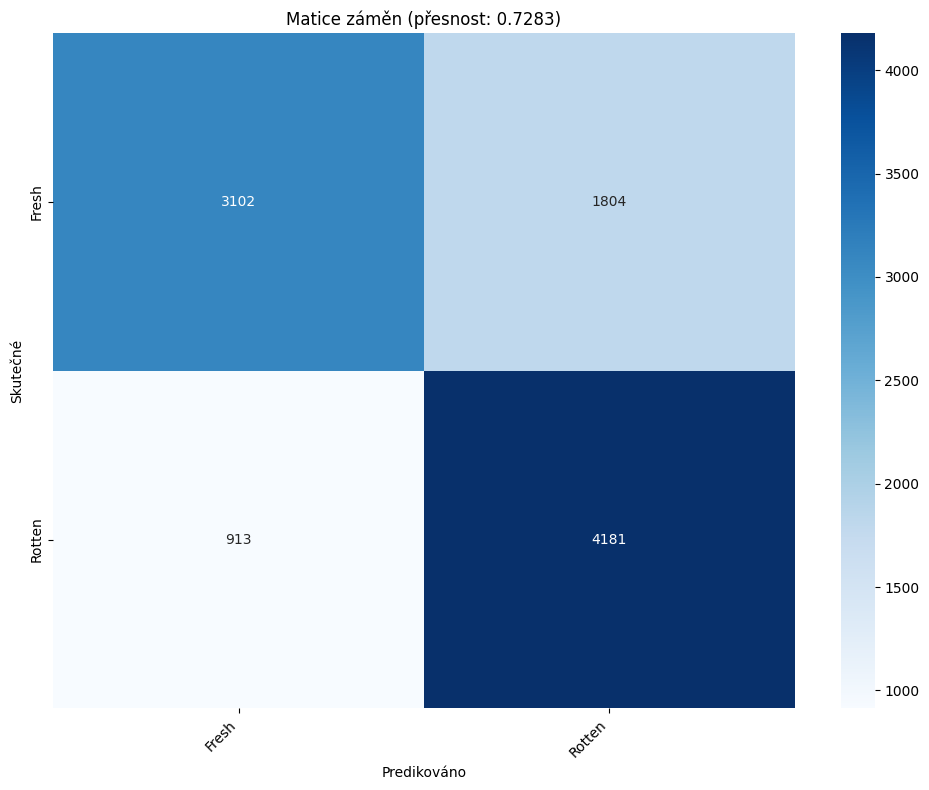

In [104]:
acc_6, report_6 = evaluate_model(model_6, X_test_pad, y_test)

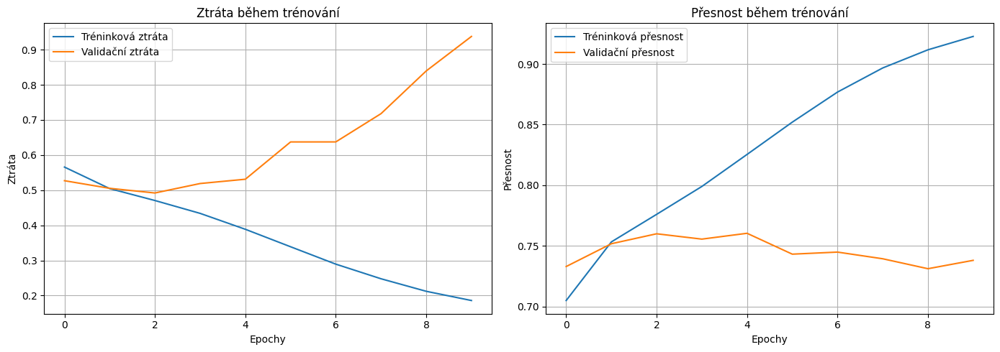

In [105]:
plot_training_history(history_6)

In [106]:
print(f"Přesnost modelu 3: {acc_3:.4f}")
print(f"Přesnost modelu 6: {acc_6:.4f}")

Přesnost modelu 3: 0.7286
Přesnost modelu 6: 0.7283


Opět jsme nedosáhli lepšího výsledku, než u modelu 3. Model 6 sice obsahuje Attention vrstvu, ale její přínos v tomto případě není dostatečný k překonání výkonu modelu 3.

## Model 7 - 🔄 Bidirectional LSTM + Attention

- **Vstup:** GloVe embedding + tokenizace  
- **LSTM:** Bidirectional LSTM 128 jednotek, return_sequences=True  
- **Dropout:** 0.3 po BiLSTM  
- **Attention:** stejný attention mechanismus jako v modelu 6  
- **Dense:** 128 → 64 neuronů s ReLU a dropout (0.4, 0.3)  
- **Výstup:** 1 neuron, sigmoid  
- **Optimalizace:** Adam, binary crossentropy  

➕ **Novinky oproti modelu 6:**  
- Bidirectional LSTM místo jednovrstvého  
- Menší dense vrstvy (128, 64 místo 256, 192, ...)  
- Lehčí, ale s obousměrným kontextem + attention  

In [107]:
def create_model_7():
	inputs, x = glove_in_emb_tokenized()

	x = Bidirectional(LSTM(128, return_sequences=True))(x)
	x = Dropout(0.3)(x)

	attention = Dense(1, activation='tanh')(x)
	attention = Flatten()(attention)
	attention = Activation('softmax')(attention)
	attention = RepeatVector(256)(attention)
	attention = Permute([2, 1])(attention)
	x = Multiply()([x, attention])
	x = Lambda(lambda z: K.sum(z, axis=1), output_shape=(256,))(x)

	x = Dense(128, activation='relu')(x)
	x = Dropout(0.4)(x)
	x = Dense(64, activation='relu')(x)
	x = Dropout(0.3)(x)

	outputs = Dense(1, activation='sigmoid')(x)

	model = Model(inputs=inputs, outputs=outputs)
	model.compile(
		optimizer='adam',
		loss='binary_crossentropy',
		metrics=['accuracy']
	)
	return model

In [108]:
model_7 = create_model_7()
model_7.summary()

GloVe vektory: 9686 nalezeno a 313 chybí


Model: "functional_6"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_6       │ (None, 128)       │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding_6         │ (None, 128, 200)  │  2,000,000 │ input_layer_6[0]… │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bidirectional_2     │ (None, 128, 256)  │    336,896 │ embedding_6[0][0] │
│ (Bidirectional)     │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_27          │ (None, 128, 256)  │          0 │ bidirectional_2[… │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_29 (Dense)    │ (None, 128, 1)    │        257 │ dropout_27[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ flatten_1 (Flatten) │ (None, 128)       │          0 │ dense_29[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_1        │ (None, 128)       │          0 │ flatten_1[0][0]   │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ repeat_vector_1     │ (None, 256, 128)  │          0 │ activation_1[0][… │
│ (RepeatVector)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ permute_1 (Permute) │ (None, 128, 256)  │          0 │ repeat_vector_1[… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ multiply_1          │ (None, 128, 256)  │          0 │ dropout_27[0][0], │
│ (Multiply)          │                   │            │ permute_1[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lambda_1 (Lambda)   │ (None, 256)       │          0 │ multiply_1[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_30 (Dense)    │ (None, 128)       │     32,896 │ lambda_1[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_28          │ (None, 128)       │          0 │ dense_30[0][0]    │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_31 (Dense)    │ (None, 64)        │      8,256 │ dropout_28[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_29          │ (None, 64)        │          0 │ dense_31[0][0]    │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_32 (Dense)    │ (None, 1)         │         65 │ dropout_29[0][0]  │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 2,378,370 (9.07 MB)

 Trainable params: 378,370 (1.44 MB)

 Non-trainable params: 2,000,000 (7.63 MB)

In [109]:
start_time = time.time()
history_7 = model_7.fit(
	X_train_pad,
	y_train,
	validation_data=(X_valid_pad, y_val),
	epochs=EPOCHS,
	batch_size=BATCH_SIZE,
	callbacks=[
		ModelCheckpoint(
			filepath='models/third/model_7.h5', 
			monitor='val_accuracy',
			save_best_only=True,
		),
		tensorboard_callback
	],
)
train_time_7 = time.time() - start_time
print(f"Trénink modelu 7 trval {train_time_7:.2f} sekund.")

Epoch 1/10
1249/1250 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - accuracy: 0.6725 - loss: 0.5983

2025-06-14 02:56:10.530815: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


1250/1250 ━━━━━━━━━━━━━━━━━━━━ 51s 38ms/step - accuracy: 0.6725 - loss: 0.5983 - val_accuracy: 0.7317 - val_loss: 0.5264
Epoch 2/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 46s 37ms/step - accuracy: 0.7498 - loss: 0.5090 - val_accuracy: 0.7500 - val_loss: 0.5074
Epoch 3/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 47s 37ms/step - accuracy: 0.7727 - loss: 0.4731 - val_accuracy: 0.7554 - val_loss: 0.4974
Epoch 4/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - accuracy: 0.7944 - loss: 0.4394 - val_accuracy: 0.7519 - val_loss: 0.5054
Epoch 5/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - accuracy: 0.8163 - loss: 0.4034 - val_accuracy: 0.7512 - val_loss: 0.5319
Epoch 6/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 45s 36ms/step - accuracy: 0.8407 - loss: 0.3626 - val_accuracy: 0.7399 - val_loss: 0.5530
Epoch 7/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - accuracy: 0.8597 - loss: 0.3205 - val_accuracy: 0.7378 - val_loss: 0.5926
Epoch 8/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - accuracy: 0.8809 - loss: 0.27

2025-06-14 03:02:52.462724: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_14}}


313/313 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step
Celková přesnost: 0.7367

Klasifikační zpráva:
              precision    recall  f1-score   support

       Fresh       0.79      0.63      0.70      4906
      Rotten       0.70      0.84      0.76      5094

    accuracy                           0.74     10000
   macro avg       0.75      0.73      0.73     10000
weighted avg       0.75      0.74      0.73     10000



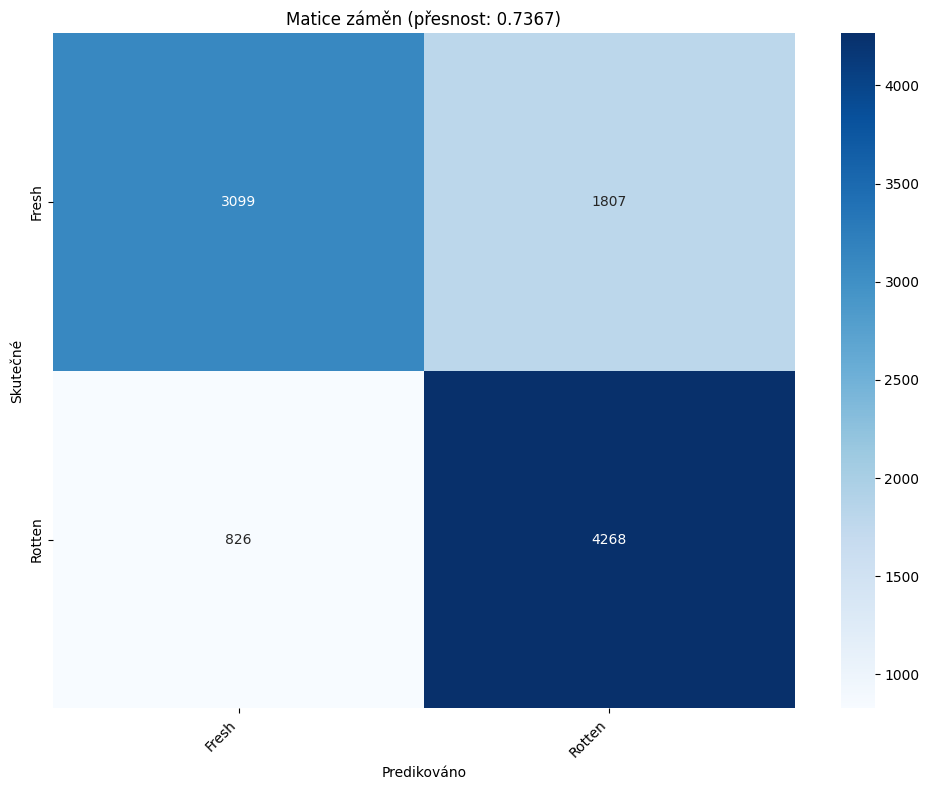

In [110]:
acc_7, report_7 = evaluate_model(model_7, X_test_pad, y_test)

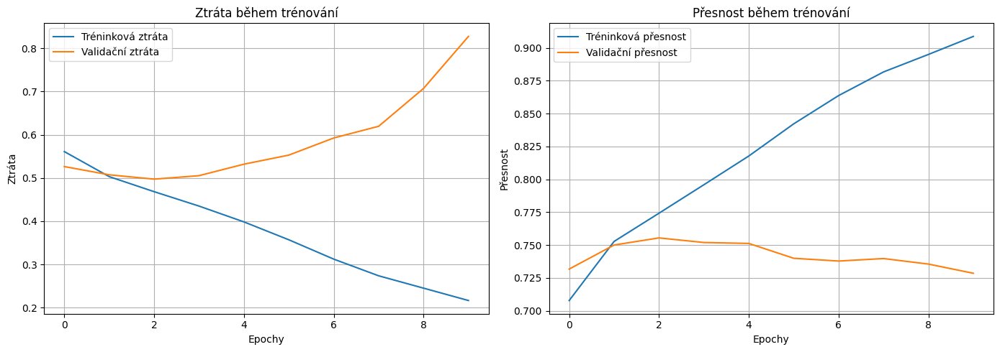

In [111]:
plot_training_history(history_7)

In [112]:
print(f"Přesnost modelu 3: {acc_3:.4f}")
print(f"Přesnost modelu 7: {acc_7:.4f}")

Přesnost modelu 3: 0.7286
Přesnost modelu 7: 0.7367


Paráda! Konečně jsme dosáhli vyšší přesnosti s modelem, který kombinuje všechny předchozí vrstvy a porazili jsme model 3. 

## Model 8 - Optuna 🎯

- **LSTM vrstvy:**  
  - `lstm_units`: počet jednotek v Bidirectional LSTM (64–256)  
  - `lstm_dropout`: dropout po LSTM (0.1–0.5)  

- **Dense vrstvy:**  
  - `dense1_units`: počet neuronů v první dense vrstvě (64–256)  
  - `dense1_dropout`: dropout po první dense vrstvě (0.2–0.5)  
  - `dense2_units`: počet neuronů ve druhé dense vrstvě (32–128)  
  - `dense2_dropout`: dropout po druhé dense vrstvě (0.1–0.4)  

- **Optimalizace:**  
  - `learning_rate`: rychlost učení (logaritmicky v rozmezí 1e-4 až 1e-2)  

- **Batch size:**  
  - `batch_size`: volba ze [16, 32, 64]  

### Nalezení nejlepších hyperparametrů

In [113]:
def create_model_8(trial):
    inputs, x = glove_in_emb_tokenized()
    
    # Tune LSTM units
    lstm_units = trial.suggest_int('lstm_units', 64, 256)
    x = Bidirectional(LSTM(lstm_units, return_sequences=True))(x)
    
    # Tune dropout rate after LSTM
    lstm_dropout = trial.suggest_float('lstm_dropout', 0.1, 0.5)
    x = Dropout(lstm_dropout)(x)

    # Attention mechanism
    attention = Dense(1, activation='tanh')(x)
    attention = Flatten()(attention)
    attention = Activation('softmax')(attention)
    attention = RepeatVector(lstm_units * 2)(attention)  # *2 for bidirectional
    attention = Permute([2, 1])(attention)
    x = Multiply()([x, attention])
    x = Lambda(lambda z: K.sum(z, axis=1), output_shape=(lstm_units * 2,))(x)

    # Tune dense layers
    dense1_units = trial.suggest_int('dense1_units', 64, 256)
    x = Dense(dense1_units, activation='relu')(x)
    
    dense1_dropout = trial.suggest_float('dense1_dropout', 0.2, 0.5)
    x = Dropout(dense1_dropout)(x)
    
    dense2_units = trial.suggest_int('dense2_units', 32, 128)
    x = Dense(dense2_units, activation='relu')(x)
    
    dense2_dropout = trial.suggest_float('dense2_dropout', 0.1, 0.4)
    x = Dropout(dense2_dropout)(x)

    # Tune learning rate
    learning_rate = trial.suggest_float('learning_rate', 1e-4, 1e-2, log=True)
    
    outputs = Dense(1, activation='sigmoid')(x)

    model = Model(inputs=inputs, outputs=outputs)
    model.compile(
        optimizer=Adam(learning_rate=learning_rate),
        loss='binary_crossentropy',
        metrics=['accuracy']
    )
    return model

In [114]:
def objective(trial):
    model = create_model_8(trial)
    
    early_stopping = EarlyStopping(
        monitor='val_loss',
        patience=3,
        restore_best_weights=True
    )
    
    history = model.fit(
        X_train_pad , y_train,
        validation_data=(X_valid_pad, y_val),
        epochs=EPOCHS,
        batch_size=trial.suggest_categorical('batch_size', [16, 32, 64]),
        callbacks=[early_stopping],
        verbose=1
    )
    
    val_accuracy = max(history.history['val_accuracy'])
    
    return val_accuracy

In [115]:
start_time = time.time()
n_trials = 20

optuna.logging.set_verbosity(verbosity=optuna.logging.WARNING)
study = optuna.create_study(direction='maximize', sampler=TPESampler(seed=SEED))

with tqdm(total=n_trials, desc="Optimalizace modelu") as pbar:
	for _ in range(n_trials):
		study.optimize(objective, n_trials=1)
		pbar.update(1)
		pbar.set_postfix({
			'Best Value': f"{study.best_trial.value:.4f}",
			'Best Params': study.best_trial.params
		})

end_time = time.time()
elapsed_time = end_time - start_time

print("\n" + "="*50)
print('Výsledky nejlepšího pokusu:')
print("="*50)
print(f'  Hodnota (přesnost validace): {study.best_trial.value:.4f}')
print('  Parametry: ')
for key, value in study.best_trial.params.items():
	print(f'    {key}: {value}')
print("="*50)
print(f"Optimalizace trvala {elapsed_time:.2f} sekund.")

Optimalizace modelu:   0%|          | 0/20 [00:00<?, ?it/s]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 166s 32ms/step - accuracy: 0.6807 - loss: 0.5942 - val_accuracy: 0.7210 - val_loss: 0.5407
Epoch 2/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 160s 32ms/step - accuracy: 0.7346 - loss: 0.5282 - val_accuracy: 0.7313 - val_loss: 0.5276
Epoch 3/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 160s 32ms/step - accuracy: 0.7501 - loss: 0.5050 - val_accuracy: 0.7386 - val_loss: 0.5216
Epoch 4/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 160s 32ms/step - accuracy: 0.7648 - loss: 0.4843 - val_accuracy: 0.7405 - val_loss: 0.5276
Epoch 5/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 161s 32ms/step - accuracy: 0.7765 - loss: 0.4682 - val_accuracy: 0.7473 - val_loss: 0.5178
Epoch 6/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 160s 32ms/step - accuracy: 0.7871 - loss: 0.4506 - val_accuracy: 0.7461 - val_loss: 0.5289
Epoch 7/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 158s 32ms/step - accuracy: 0.7992 - loss: 0.4353 - val_accuracy: 0.7470 - val_loss: 0.5232
Epoch 8/10
5000/5000 ━━━━━━━

Optimalizace modelu:   5%|▌         | 1/20 [21:36<6:50:33, 1296.52s/it, Best Value=0.7473, Best Params={'lstm_units': 136, 'lstm_dropout': 0.4802857225639665, 'dense1_units': 205, 'dense1_dropout': 0.379597545259111, 'dense2_units': 47, 'dense2_dropout': 0.1467983561008608, 'learning_rate': 0.00013066739238053285, 'batch_size': 16}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 169s 33ms/step - accuracy: 0.6906 - loss: 0.5752 - val_accuracy: 0.7313 - val_loss: 0.5213
Epoch 2/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 166s 33ms/step - accuracy: 0.7516 - loss: 0.5040 - val_accuracy: 0.7434 - val_loss: 0.5096
Epoch 3/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 166s 33ms/step - accuracy: 0.7702 - loss: 0.4761 - val_accuracy: 0.7520 - val_loss: 0.5057
Epoch 4/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 165s 33ms/step - accuracy: 0.7871 - loss: 0.4498 - val_accuracy: 0.7540 - val_loss: 0.5058
Epoch 5/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 165s 33ms/step - accuracy: 0.8018 - loss: 0.4267 - val_accuracy: 0.7586 - val_loss: 0.5040
Epoch 6/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 168s 34ms/step - accuracy: 0.8166 - loss: 0.4021 - val_accuracy: 0.7600 - val_loss: 0.5183
Epoch 7/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 166s 33ms/step - accuracy: 0.8307 - loss: 0.3792 - val_accuracy: 0.7593 - val_loss: 0.5435
Epoch 8/10
5000/5000 ━━━━━━━

Optimalizace modelu:  10%|█         | 2/20 [43:58<6:36:56, 1323.14s/it, Best Value=0.7600, Best Params={'lstm_units': 67, 'lstm_dropout': 0.4879639408647978, 'dense1_units': 224, 'dense1_dropout': 0.26370173320348284, 'dense2_units': 49, 'dense2_dropout': 0.15502135295603015, 'learning_rate': 0.0004059611610484307, 'batch_size': 16}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
2499/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - accuracy: 0.6783 - loss: 0.5918

2025-06-14 03:48:26.448278: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 85s 32ms/step - accuracy: 0.6783 - loss: 0.5918 - val_accuracy: 0.7164 - val_loss: 0.5437
Epoch 2/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 79s 32ms/step - accuracy: 0.7343 - loss: 0.5285 - val_accuracy: 0.7309 - val_loss: 0.5457
Epoch 3/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 80s 32ms/step - accuracy: 0.7520 - loss: 0.5041 - val_accuracy: 0.7397 - val_loss: 0.5200
Epoch 4/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 81s 32ms/step - accuracy: 0.7670 - loss: 0.4824 - val_accuracy: 0.7421 - val_loss: 0.5121
Epoch 5/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 80s 32ms/step - accuracy: 0.7817 - loss: 0.4600 - val_accuracy: 0.7529 - val_loss: 0.4971
Epoch 6/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 81s 32ms/step - accuracy: 0.7984 - loss: 0.4358 - val_accuracy: 0.7555 - val_loss: 0.4936
Epoch 7/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 81s 32ms/step - accuracy: 0.8122 - loss: 0.4125 - val_accuracy: 0.7524 - val_loss: 0.5101
Epoch 8/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 81s 33ms/step - accuracy: 0.8285 - loss: 0.38

Optimalizace modelu:  15%|█▌        | 3/20 [56:19<4:59:37, 1057.48s/it, Best Value=0.7600, Best Params={'lstm_units': 67, 'lstm_dropout': 0.4879639408647978, 'dense1_units': 224, 'dense1_dropout': 0.26370173320348284, 'dense2_units': 49, 'dense2_dropout': 0.15502135295603015, 'learning_rate': 0.0004059611610484307, 'batch_size': 16}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
2499/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - accuracy: 0.6785 - loss: 0.5922

2025-06-14 04:00:52.589096: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 89s 34ms/step - accuracy: 0.6785 - loss: 0.5922 - val_accuracy: 0.7266 - val_loss: 0.5323
Epoch 2/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 85s 34ms/step - accuracy: 0.7471 - loss: 0.5108 - val_accuracy: 0.7451 - val_loss: 0.5083
Epoch 3/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 85s 34ms/step - accuracy: 0.7687 - loss: 0.4803 - val_accuracy: 0.7568 - val_loss: 0.4927
Epoch 4/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 86s 34ms/step - accuracy: 0.7854 - loss: 0.4555 - val_accuracy: 0.7365 - val_loss: 0.5264
Epoch 5/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 86s 34ms/step - accuracy: 0.8001 - loss: 0.4307 - val_accuracy: 0.7613 - val_loss: 0.4855
Epoch 6/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 86s 34ms/step - accuracy: 0.8204 - loss: 0.3972 - val_accuracy: 0.7573 - val_loss: 0.4971
Epoch 7/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 87s 35ms/step - accuracy: 0.8423 - loss: 0.3607 - val_accuracy: 0.7492 - val_loss: 0.5366
Epoch 8/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 82s 33ms/step - accuracy: 0.8617 - loss: 0.32

Optimalizace modelu:  20%|██        | 4/20 [1:07:56<4:04:01, 915.09s/it, Best Value=0.7613, Best Params={'lstm_units': 181, 'lstm_dropout': 0.16820964947491662, 'dense1_units': 76, 'dense1_dropout': 0.48466566117599996, 'dense2_units': 125, 'dense2_dropout': 0.3425192044349384, 'learning_rate': 0.0004066563313514797, 'batch_size': 32}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - accuracy: 0.6719 - loss: 0.5995

2025-06-14 04:12:26.398523: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 86s 33ms/step - accuracy: 0.6719 - loss: 0.5994 - val_accuracy: 0.7250 - val_loss: 0.5319
Epoch 2/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 79s 32ms/step - accuracy: 0.7431 - loss: 0.5195 - val_accuracy: 0.7448 - val_loss: 0.5095
Epoch 3/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 79s 32ms/step - accuracy: 0.7619 - loss: 0.4896 - val_accuracy: 0.7468 - val_loss: 0.5027
Epoch 4/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 79s 31ms/step - accuracy: 0.7779 - loss: 0.4661 - val_accuracy: 0.7547 - val_loss: 0.4956
Epoch 5/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 79s 31ms/step - accuracy: 0.7937 - loss: 0.4437 - val_accuracy: 0.7577 - val_loss: 0.4891
Epoch 6/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 77s 31ms/step - accuracy: 0.8087 - loss: 0.4202 - val_accuracy: 0.7619 - val_loss: 0.4907
Epoch 7/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 79s 32ms/step - accuracy: 0.8229 - loss: 0.3968 - val_accuracy: 0.7614 - val_loss: 0.4919
Epoch 8/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 85s 33ms/step - accuracy: 0.8377 - loss: 0.37

Optimalizace modelu:  25%|██▌       | 5/20 [1:18:50<3:25:14, 820.98s/it, Best Value=0.7619, Best Params={'lstm_units': 87, 'lstm_dropout': 0.29807076404450805, 'dense1_units': 70, 'dense1_dropout': 0.47279612062363463, 'dense2_units': 57, 'dense2_dropout': 0.2987566853061946, 'learning_rate': 0.0004201672054372534, 'batch_size': 32}]  

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
1249/1250 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - accuracy: 0.6645 - loss: 0.6088

2025-06-14 04:22:52.213142: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


1250/1250 ━━━━━━━━━━━━━━━━━━━━ 56s 41ms/step - accuracy: 0.6646 - loss: 0.6087 - val_accuracy: 0.7159 - val_loss: 0.5537
Epoch 2/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 53s 42ms/step - accuracy: 0.7294 - loss: 0.5408 - val_accuracy: 0.7272 - val_loss: 0.5348
Epoch 3/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 52s 42ms/step - accuracy: 0.7430 - loss: 0.5198 - val_accuracy: 0.7318 - val_loss: 0.5269
Epoch 4/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 53s 42ms/step - accuracy: 0.7557 - loss: 0.5008 - val_accuracy: 0.7391 - val_loss: 0.5155
Epoch 5/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 54s 43ms/step - accuracy: 0.7695 - loss: 0.4832 - val_accuracy: 0.7427 - val_loss: 0.5102
Epoch 6/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 57s 45ms/step - accuracy: 0.7774 - loss: 0.4692 - val_accuracy: 0.7381 - val_loss: 0.5144
Epoch 7/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 54s 43ms/step - accuracy: 0.7862 - loss: 0.4565 - val_accuracy: 0.7341 - val_loss: 0.5159
Epoch 8/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 55s 44ms/step - accuracy: 0.7940 - loss: 0.44

Optimalizace modelu:  30%|███       | 6/20 [1:26:15<2:41:44, 693.15s/it, Best Value=0.7619, Best Params={'lstm_units': 87, 'lstm_dropout': 0.29807076404450805, 'dense1_units': 70, 'dense1_dropout': 0.47279612062363463, 'dense2_units': 57, 'dense2_dropout': 0.2987566853061946, 'learning_rate': 0.0004201672054372534, 'batch_size': 32}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - accuracy: 0.6713 - loss: 0.6040

2025-06-14 04:30:09.463315: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


1250/1250 ━━━━━━━━━━━━━━━━━━━━ 49s 36ms/step - accuracy: 0.6713 - loss: 0.6039 - val_accuracy: 0.7192 - val_loss: 0.5484
Epoch 2/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - accuracy: 0.7323 - loss: 0.5333 - val_accuracy: 0.7311 - val_loss: 0.5281
Epoch 3/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - accuracy: 0.7481 - loss: 0.5099 - val_accuracy: 0.7368 - val_loss: 0.5191
Epoch 4/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - accuracy: 0.7614 - loss: 0.4907 - val_accuracy: 0.7440 - val_loss: 0.5086
Epoch 5/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - accuracy: 0.7729 - loss: 0.4747 - val_accuracy: 0.7454 - val_loss: 0.5074
Epoch 6/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - accuracy: 0.7807 - loss: 0.4624 - val_accuracy: 0.7486 - val_loss: 0.5025
Epoch 7/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - accuracy: 0.7905 - loss: 0.4477 - val_accuracy: 0.7483 - val_loss: 0.5054
Epoch 8/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - accuracy: 0.8006 - loss: 0.43

Optimalizace modelu:  35%|███▌      | 7/20 [1:33:42<2:12:42, 612.50s/it, Best Value=0.7619, Best Params={'lstm_units': 87, 'lstm_dropout': 0.29807076404450805, 'dense1_units': 70, 'dense1_dropout': 0.47279612062363463, 'dense2_units': 57, 'dense2_dropout': 0.2987566853061946, 'learning_rate': 0.0004201672054372534, 'batch_size': 32}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - accuracy: 0.5011 - loss: 0.6989

2025-06-14 04:38:17.558471: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 92s 35ms/step - accuracy: 0.5011 - loss: 0.6989 - val_accuracy: 0.4975 - val_loss: 0.6932
Epoch 2/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 88s 35ms/step - accuracy: 0.4963 - loss: 0.6932 - val_accuracy: 0.5025 - val_loss: 0.6931
Epoch 3/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 88s 35ms/step - accuracy: 0.4995 - loss: 0.6932 - val_accuracy: 0.5025 - val_loss: 0.6931
Epoch 4/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 88s 35ms/step - accuracy: 0.4999 - loss: 0.6932 - val_accuracy: 0.5025 - val_loss: 0.6931
Epoch 5/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 89s 35ms/step - accuracy: 0.4999 - loss: 0.6932 - val_accuracy: 0.5025 - val_loss: 0.6931
Epoch 6/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 88s 35ms/step - accuracy: 0.4999 - loss: 0.6932 - val_accuracy: 0.5025 - val_loss: 0.6931


Optimalizace modelu:  40%|████      | 8/20 [1:42:45<1:58:07, 590.62s/it, Best Value=0.7619, Best Params={'lstm_units': 87, 'lstm_dropout': 0.29807076404450805, 'dense1_units': 70, 'dense1_dropout': 0.47279612062363463, 'dense2_units': 57, 'dense2_dropout': 0.2987566853061946, 'learning_rate': 0.0004201672054372534, 'batch_size': 32}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - accuracy: 0.6982 - loss: 0.5658

2025-06-14 04:47:22.169080: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 93s 36ms/step - accuracy: 0.6982 - loss: 0.5658 - val_accuracy: 0.7582 - val_loss: 0.4872
Epoch 2/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 89s 35ms/step - accuracy: 0.7699 - loss: 0.4789 - val_accuracy: 0.7686 - val_loss: 0.4801
Epoch 3/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 89s 36ms/step - accuracy: 0.8065 - loss: 0.4200 - val_accuracy: 0.7696 - val_loss: 0.5259
Epoch 4/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 90s 36ms/step - accuracy: 0.8399 - loss: 0.3602 - val_accuracy: 0.7647 - val_loss: 0.5592
Epoch 5/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 89s 36ms/step - accuracy: 0.8699 - loss: 0.3017 - val_accuracy: 0.7572 - val_loss: 0.6244


Optimalizace modelu:  45%|████▌     | 9/20 [1:50:26<1:40:49, 549.91s/it, Best Value=0.7696, Best Params={'lstm_units': 230, 'lstm_dropout': 0.3493192507310232, 'dense1_units': 127, 'dense1_dropout': 0.2190675050858071, 'dense2_units': 62, 'dense2_dropout': 0.1975549966080241, 'learning_rate': 0.002878805718308925, 'batch_size': 32}] 

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 171s 33ms/step - accuracy: 0.6947 - loss: 0.5670 - val_accuracy: 0.7472 - val_loss: 0.5059
Epoch 2/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 167s 33ms/step - accuracy: 0.7643 - loss: 0.4834 - val_accuracy: 0.7640 - val_loss: 0.4830
Epoch 3/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 167s 33ms/step - accuracy: 0.7910 - loss: 0.4411 - val_accuracy: 0.7681 - val_loss: 0.4888
Epoch 4/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 166s 33ms/step - accuracy: 0.8179 - loss: 0.3980 - val_accuracy: 0.7699 - val_loss: 0.5234
Epoch 5/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 166s 33ms/step - accuracy: 0.8423 - loss: 0.3526 - val_accuracy: 0.7606 - val_loss: 0.5628


Optimalizace modelu:  50%|█████     | 10/20 [2:04:35<1:47:02, 642.29s/it, Best Value=0.7699, Best Params={'lstm_units': 87, 'lstm_dropout': 0.38529791488919807, 'dense1_units': 210, 'dense1_dropout': 0.36838315927084886, 'dense2_units': 106, 'dense2_dropout': 0.24813867890931726, 'learning_rate': 0.0011103647313054626, 'batch_size': 16}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 168s 33ms/step - accuracy: 0.7002 - loss: 0.5644 - val_accuracy: 0.7486 - val_loss: 0.4987
Epoch 2/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 161s 32ms/step - accuracy: 0.7670 - loss: 0.4811 - val_accuracy: 0.7593 - val_loss: 0.4907
Epoch 3/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 163s 32ms/step - accuracy: 0.7956 - loss: 0.4377 - val_accuracy: 0.7648 - val_loss: 0.4899
Epoch 4/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 164s 33ms/step - accuracy: 0.8236 - loss: 0.3892 - val_accuracy: 0.7563 - val_loss: 0.5187
Epoch 5/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 163s 33ms/step - accuracy: 0.8475 - loss: 0.3422 - val_accuracy: 0.7645 - val_loss: 0.5762
Epoch 6/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 163s 33ms/step - accuracy: 0.8743 - loss: 0.2906 - val_accuracy: 0.7603 - val_loss: 0.6579


Optimalizace modelu:  55%|█████▌    | 11/20 [2:21:08<1:52:26, 749.58s/it, Best Value=0.7699, Best Params={'lstm_units': 87, 'lstm_dropout': 0.38529791488919807, 'dense1_units': 210, 'dense1_dropout': 0.36838315927084886, 'dense2_units': 106, 'dense2_dropout': 0.24813867890931726, 'learning_rate': 0.0011103647313054626, 'batch_size': 16}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 172s 34ms/step - accuracy: 0.4991 - loss: 0.6985 - val_accuracy: 0.4975 - val_loss: 0.6944
Epoch 2/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 167s 33ms/step - accuracy: 0.4981 - loss: 0.6936 - val_accuracy: 0.4975 - val_loss: 0.6944
Epoch 3/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 166s 33ms/step - accuracy: 0.4981 - loss: 0.6936 - val_accuracy: 0.4975 - val_loss: 0.6944
Epoch 4/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 166s 33ms/step - accuracy: 0.4981 - loss: 0.6936 - val_accuracy: 0.4975 - val_loss: 0.6944


Optimalizace modelu:  60%|██████    | 12/20 [2:32:30<1:37:13, 729.17s/it, Best Value=0.7699, Best Params={'lstm_units': 87, 'lstm_dropout': 0.38529791488919807, 'dense1_units': 210, 'dense1_dropout': 0.36838315927084886, 'dense2_units': 106, 'dense2_dropout': 0.24813867890931726, 'learning_rate': 0.0011103647313054626, 'batch_size': 16}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - accuracy: 0.6852 - loss: 0.5782

2025-06-14 05:37:05.705481: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 92s 35ms/step - accuracy: 0.6852 - loss: 0.5782 - val_accuracy: 0.7490 - val_loss: 0.5025
Epoch 2/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 87s 35ms/step - accuracy: 0.7633 - loss: 0.4847 - val_accuracy: 0.7587 - val_loss: 0.4891
Epoch 3/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 88s 35ms/step - accuracy: 0.7937 - loss: 0.4384 - val_accuracy: 0.7674 - val_loss: 0.4881
Epoch 4/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 89s 35ms/step - accuracy: 0.8246 - loss: 0.3847 - val_accuracy: 0.7691 - val_loss: 0.5411
Epoch 5/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 87s 35ms/step - accuracy: 0.8583 - loss: 0.3258 - val_accuracy: 0.7569 - val_loss: 0.5797
Epoch 6/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 89s 35ms/step - accuracy: 0.8835 - loss: 0.2704 - val_accuracy: 0.7558 - val_loss: 0.6647


Optimalizace modelu:  65%|██████▌   | 13/20 [2:41:33<1:18:28, 672.70s/it, Best Value=0.7699, Best Params={'lstm_units': 87, 'lstm_dropout': 0.38529791488919807, 'dense1_units': 210, 'dense1_dropout': 0.36838315927084886, 'dense2_units': 106, 'dense2_dropout': 0.24813867890931726, 'learning_rate': 0.0011103647313054626, 'batch_size': 16}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 171s 33ms/step - accuracy: 0.6975 - loss: 0.5671 - val_accuracy: 0.7418 - val_loss: 0.5103
Epoch 2/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 164s 33ms/step - accuracy: 0.7672 - loss: 0.4830 - val_accuracy: 0.7619 - val_loss: 0.4979
Epoch 3/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 165s 33ms/step - accuracy: 0.7983 - loss: 0.4346 - val_accuracy: 0.7683 - val_loss: 0.5026
Epoch 4/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 163s 33ms/step - accuracy: 0.8217 - loss: 0.3892 - val_accuracy: 0.7655 - val_loss: 0.5650
Epoch 5/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 162s 32ms/step - accuracy: 0.8438 - loss: 0.3517 - val_accuracy: 0.7591 - val_loss: 0.5520


Optimalizace modelu:  70%|███████   | 14/20 [2:55:28<1:12:11, 721.83s/it, Best Value=0.7699, Best Params={'lstm_units': 87, 'lstm_dropout': 0.38529791488919807, 'dense1_units': 210, 'dense1_dropout': 0.36838315927084886, 'dense2_units': 106, 'dense2_dropout': 0.24813867890931726, 'learning_rate': 0.0011103647313054626, 'batch_size': 16}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
1249/1250 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - accuracy: 0.6175 - loss: 0.6389

2025-06-14 05:59:27.898923: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


1250/1250 ━━━━━━━━━━━━━━━━━━━━ 53s 39ms/step - accuracy: 0.6176 - loss: 0.6388 - val_accuracy: 0.7383 - val_loss: 0.5252
Epoch 2/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 52s 41ms/step - accuracy: 0.7546 - loss: 0.5036 - val_accuracy: 0.7480 - val_loss: 0.5078
Epoch 3/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 51s 41ms/step - accuracy: 0.7845 - loss: 0.4630 - val_accuracy: 0.7440 - val_loss: 0.5197
Epoch 4/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 52s 42ms/step - accuracy: 0.8064 - loss: 0.4275 - val_accuracy: 0.7518 - val_loss: 0.5251
Epoch 5/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 52s 41ms/step - accuracy: 0.8224 - loss: 0.3958 - val_accuracy: 0.7529 - val_loss: 0.5272


Optimalizace modelu:  75%|███████▌  | 15/20 [3:00:01<48:51, 586.34s/it, Best Value=0.7699, Best Params={'lstm_units': 87, 'lstm_dropout': 0.38529791488919807, 'dense1_units': 210, 'dense1_dropout': 0.36838315927084886, 'dense2_units': 106, 'dense2_dropout': 0.24813867890931726, 'learning_rate': 0.0011103647313054626, 'batch_size': 16}]  

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
2499/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - accuracy: 0.6968 - loss: 0.5653

2025-06-14 06:04:28.669105: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 84s 32ms/step - accuracy: 0.6968 - loss: 0.5653 - val_accuracy: 0.7572 - val_loss: 0.4935
Epoch 2/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 81s 32ms/step - accuracy: 0.7689 - loss: 0.4803 - val_accuracy: 0.7604 - val_loss: 0.4847
Epoch 3/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 78s 31ms/step - accuracy: 0.7972 - loss: 0.4343 - val_accuracy: 0.7625 - val_loss: 0.4998
Epoch 4/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 80s 32ms/step - accuracy: 0.8251 - loss: 0.3844 - val_accuracy: 0.7640 - val_loss: 0.5173
Epoch 5/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 79s 32ms/step - accuracy: 0.8537 - loss: 0.3314 - val_accuracy: 0.7555 - val_loss: 0.6188


Optimalizace modelu:  80%|████████  | 16/20 [3:06:54<35:37, 534.27s/it, Best Value=0.7699, Best Params={'lstm_units': 87, 'lstm_dropout': 0.38529791488919807, 'dense1_units': 210, 'dense1_dropout': 0.36838315927084886, 'dense2_units': 106, 'dense2_dropout': 0.24813867890931726, 'learning_rate': 0.0011103647313054626, 'batch_size': 16}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 167s 32ms/step - accuracy: 0.6958 - loss: 0.5663 - val_accuracy: 0.7451 - val_loss: 0.5078
Epoch 2/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 161s 32ms/step - accuracy: 0.7636 - loss: 0.4855 - val_accuracy: 0.7535 - val_loss: 0.5002
Epoch 3/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 162s 32ms/step - accuracy: 0.7928 - loss: 0.4391 - val_accuracy: 0.7645 - val_loss: 0.5124
Epoch 4/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 162s 32ms/step - accuracy: 0.8241 - loss: 0.3872 - val_accuracy: 0.7623 - val_loss: 0.5481
Epoch 5/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 162s 32ms/step - accuracy: 0.8578 - loss: 0.3265 - val_accuracy: 0.7620 - val_loss: 0.6458


Optimalizace modelu:  85%|████████▌ | 17/20 [3:20:39<31:05, 621.68s/it, Best Value=0.7699, Best Params={'lstm_units': 87, 'lstm_dropout': 0.38529791488919807, 'dense1_units': 210, 'dense1_dropout': 0.36838315927084886, 'dense2_units': 106, 'dense2_dropout': 0.24813867890931726, 'learning_rate': 0.0011103647313054626, 'batch_size': 16}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
2498/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - accuracy: 0.6875 - loss: 0.5806

2025-06-14 06:25:06.441643: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 84s 32ms/step - accuracy: 0.6875 - loss: 0.5806 - val_accuracy: 0.7275 - val_loss: 0.5264
Epoch 2/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 78s 31ms/step - accuracy: 0.7527 - loss: 0.5037 - val_accuracy: 0.7534 - val_loss: 0.4968
Epoch 3/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 78s 31ms/step - accuracy: 0.7758 - loss: 0.4698 - val_accuracy: 0.7569 - val_loss: 0.4911
Epoch 4/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 79s 32ms/step - accuracy: 0.7949 - loss: 0.4392 - val_accuracy: 0.7577 - val_loss: 0.4912
Epoch 5/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 79s 31ms/step - accuracy: 0.8121 - loss: 0.4140 - val_accuracy: 0.7612 - val_loss: 0.4946
Epoch 6/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 80s 32ms/step - accuracy: 0.8327 - loss: 0.3804 - val_accuracy: 0.7558 - val_loss: 0.5006


Optimalizace modelu:  90%|█████████ | 18/20 [3:28:48<19:23, 581.82s/it, Best Value=0.7699, Best Params={'lstm_units': 87, 'lstm_dropout': 0.38529791488919807, 'dense1_units': 210, 'dense1_dropout': 0.36838315927084886, 'dense2_units': 106, 'dense2_dropout': 0.24813867890931726, 'learning_rate': 0.0011103647313054626, 'batch_size': 16}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 169s 33ms/step - accuracy: 0.6685 - loss: 0.5842 - val_accuracy: 0.7274 - val_loss: 0.5662
Epoch 2/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 163s 33ms/step - accuracy: 0.7660 - loss: 0.4874 - val_accuracy: 0.7614 - val_loss: 0.4939
Epoch 3/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 165s 33ms/step - accuracy: 0.7861 - loss: 0.4534 - val_accuracy: 0.7593 - val_loss: 0.4971
Epoch 4/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 164s 33ms/step - accuracy: 0.7919 - loss: 0.4412 - val_accuracy: 0.7223 - val_loss: 0.6223
Epoch 5/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 164s 33ms/step - accuracy: 0.7831 - loss: 0.4590 - val_accuracy: 0.7496 - val_loss: 0.5339


Optimalizace modelu:  95%|█████████▌| 19/20 [3:42:43<10:57, 657.94s/it, Best Value=0.7699, Best Params={'lstm_units': 87, 'lstm_dropout': 0.38529791488919807, 'dense1_units': 210, 'dense1_dropout': 0.36838315927084886, 'dense2_units': 106, 'dense2_dropout': 0.24813867890931726, 'learning_rate': 0.0011103647313054626, 'batch_size': 16}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
1249/1250 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - accuracy: 0.6854 - loss: 0.5800

2025-06-14 06:46:42.963466: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


1250/1250 ━━━━━━━━━━━━━━━━━━━━ 54s 39ms/step - accuracy: 0.6854 - loss: 0.5800 - val_accuracy: 0.7346 - val_loss: 0.5255
Epoch 2/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 49s 39ms/step - accuracy: 0.7510 - loss: 0.5046 - val_accuracy: 0.7443 - val_loss: 0.5118
Epoch 3/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 49s 39ms/step - accuracy: 0.7735 - loss: 0.4732 - val_accuracy: 0.7435 - val_loss: 0.5054
Epoch 4/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 49s 39ms/step - accuracy: 0.7934 - loss: 0.4408 - val_accuracy: 0.7603 - val_loss: 0.4916
Epoch 5/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 50s 40ms/step - accuracy: 0.8158 - loss: 0.4038 - val_accuracy: 0.7454 - val_loss: 0.5170
Epoch 6/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 49s 39ms/step - accuracy: 0.8415 - loss: 0.3609 - val_accuracy: 0.7403 - val_loss: 0.5487
Epoch 7/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 50s 40ms/step - accuracy: 0.8626 - loss: 0.3166 - val_accuracy: 0.7412 - val_loss: 0.5943


Optimalizace modelu: 100%|██████████| 20/20 [3:48:44<00:00, 686.22s/it, Best Value=0.7699, Best Params={'lstm_units': 87, 'lstm_dropout': 0.38529791488919807, 'dense1_units': 210, 'dense1_dropout': 0.36838315927084886, 'dense2_units': 106, 'dense2_dropout': 0.24813867890931726, 'learning_rate': 0.0011103647313054626, 'batch_size': 16}]


Výsledky nejlepšího pokusu:
  Hodnota (přesnost validace): 0.7699
  Parametry: 
    lstm_units: 87
    lstm_dropout: 0.38529791488919807
    dense1_units: 210
    dense1_dropout: 0.36838315927084886
    dense2_units: 106
    dense2_dropout: 0.24813867890931726
    learning_rate: 0.0011103647313054626
    batch_size: 16
Optimalizace trvala 13724.31 sekund.


### Samotný trénink "nejlepšího" modelu

In [116]:
def create_model_8():
	params = study.best_trial.params
	
	print(f"\nVytváříme model s nejlepšími parametry...")
	print(f"  LSTM jednotky: {params['lstm_units']}")
	print(f"  LSTM dropout: {params['lstm_dropout']:.2f}")
	print(f"  Husté vrstvy: {params['dense1_units']} -> {params['dense2_units']}")
	print(f"  Dropouty: {params['dense1_dropout']:.2f} -> {params['dense2_dropout']:.2f}")
	print(f"  Rychlost učení: {params['learning_rate']:.6f}")
	print(f"  Velikost dávky: {params['batch_size']}")
	
	inputs, x = glove_in_emb_tokenized()
	
	x = Bidirectional(LSTM(params['lstm_units'], return_sequences=True))(x)
	x = Dropout(params['lstm_dropout'])(x)
	
	attention = Dense(1, activation='tanh')(x)
	attention = Flatten()(attention)
	attention = Activation('softmax')(attention)
	attention = RepeatVector(params['lstm_units'] * 2)(attention)
	attention = Permute([2, 1])(attention)
	x = Multiply()([x, attention])
	x = Lambda(lambda z: K.sum(z, axis=1))(x)
	
	x = Dense(params['dense1_units'], activation='relu')(x)
	x = Dropout(params['dense1_dropout'])(x)
	x = Dense(params['dense2_units'], activation='relu')(x)
	x = Dropout(params['dense2_dropout'])(x)
	
	outputs = Dense(1, activation='sigmoid')(x)
	
	model = Model(inputs=inputs, outputs=outputs)
	model.compile(
		optimizer=Adam(learning_rate=params['learning_rate']),
		loss='binary_crossentropy',
		metrics=['accuracy']
	)
	return model

In [117]:
model_8 = create_model_8()
model_8.summary()


Vytváříme model s nejlepšími parametry...
  LSTM jednotky: 87
  LSTM dropout: 0.39
  Husté vrstvy: 210 -> 106
  Dropouty: 0.37 -> 0.25
  Rychlost učení: 0.001110
  Velikost dávky: 16


GloVe vektory: 9686 nalezeno a 313 chybí


Model: "functional_27"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_27      │ (None, 128)       │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding_27        │ (None, 128, 200)  │  2,000,000 │ input_layer_27[0… │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bidirectional_23    │ (None, 128, 174)  │    200,448 │ embedding_27[0][… │
│ (Bidirectional)     │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_90          │ (None, 128, 174)  │          0 │ bidirectional_23… │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_113 (Dense)   │ (None, 128, 1)    │        175 │ dropout_90[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ flatten_22          │ (None, 128)       │          0 │ dense_113[0][0]   │
│ (Flatten)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_22       │ (None, 128)       │          0 │ flatten_22[0][0]  │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ repeat_vector_22    │ (None, 174, 128)  │          0 │ activation_22[0]… │
│ (RepeatVector)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ permute_22          │ (None, 128, 174)  │          0 │ repeat_vector_22… │
│ (Permute)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ multiply_22         │ (None, 128, 174)  │          0 │ dropout_90[0][0], │
│ (Multiply)          │                   │            │ permute_22[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lambda_22 (Lambda)  │ (None, 174)       │          0 │ multiply_22[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_114 (Dense)   │ (None, 210)       │     36,750 │ lambda_22[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_91          │ (None, 210)       │          0 │ dense_114[0][0]   │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_115 (Dense)   │ (None, 106)       │     22,366 │ dropout_91[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_92          │ (None, 106)       │          0 │ dense_115[0][0]   │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_116 (Dense)   │ (None, 1)         │        107 │ dropout_92[0][0]  │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 2,259,846 (8.62 MB)

 Trainable params: 259,846 (1015.02 KB)

 Non-trainable params: 2,000,000 (7.63 MB)

In [118]:
start_time = time.time()
history_8 = model_8.fit(
	X_train_pad,
	y_train,
	validation_data=(X_valid_pad, y_val),
	epochs=EPOCHS,
	batch_size=study.best_trial.params['batch_size'],
	callbacks=[
		ModelCheckpoint(
			filepath='models/third/model_8.h5', 
			monitor='val_accuracy',
			save_best_only=True,
		),
		tensorboard_callback
	],
)
train_time_8 = time.time() - start_time
print(f"Trénink modelu 8 trval {train_time_8:.2f} sekund.")

Epoch 1/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 172s 34ms/step - accuracy: 0.6942 - loss: 0.5666 - val_accuracy: 0.7452 - val_loss: 0.5061
Epoch 2/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 178s 36ms/step - accuracy: 0.7642 - loss: 0.4846 - val_accuracy: 0.7640 - val_loss: 0.4861
Epoch 3/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 175s 35ms/step - accuracy: 0.7935 - loss: 0.4400 - val_accuracy: 0.7673 - val_loss: 0.4853
Epoch 4/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 178s 36ms/step - accuracy: 0.8203 - loss: 0.3969 - val_accuracy: 0.7692 - val_loss: 0.5127
Epoch 5/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 176s 35ms/step - accuracy: 0.8461 - loss: 0.3505 - val_accuracy: 0.7644 - val_loss: 0.5718
Epoch 6/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 175s 35ms/step - accuracy: 0.8661 - loss: 0.3086 - val_accuracy: 0.7605 - val_loss: 0.6369
Epoch 7/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 176s 35ms/step - accuracy: 0.8832 - loss: 0.2708 - val_accuracy: 0.7594 - val_loss: 0.6680
Epoch 8/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 174s 35ms/step - accuracy: 

2025-06-14 07:21:11.780279: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_14}}


313/313 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step
Celková přesnost: 0.7473

Klasifikační zpráva:
              precision    recall  f1-score   support

       Fresh       0.76      0.71      0.73      4906
      Rotten       0.74      0.78      0.76      5094

    accuracy                           0.75     10000
   macro avg       0.75      0.75      0.75     10000
weighted avg       0.75      0.75      0.75     10000



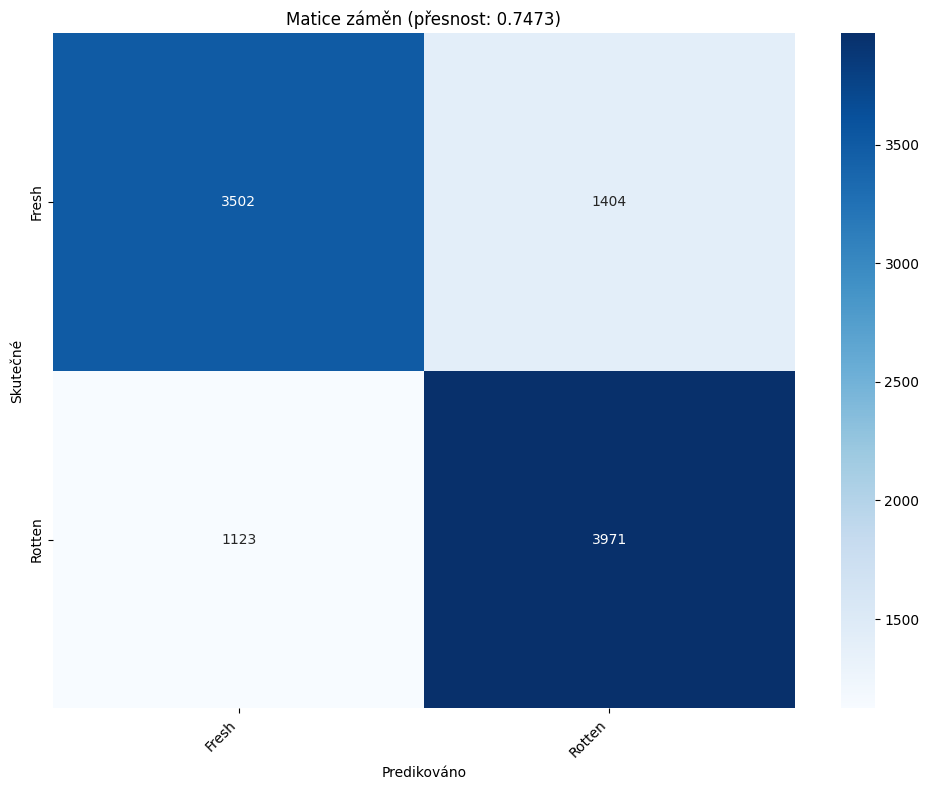

In [119]:
acc_8, report_8 = evaluate_model(model_8, X_test_pad, y_test)

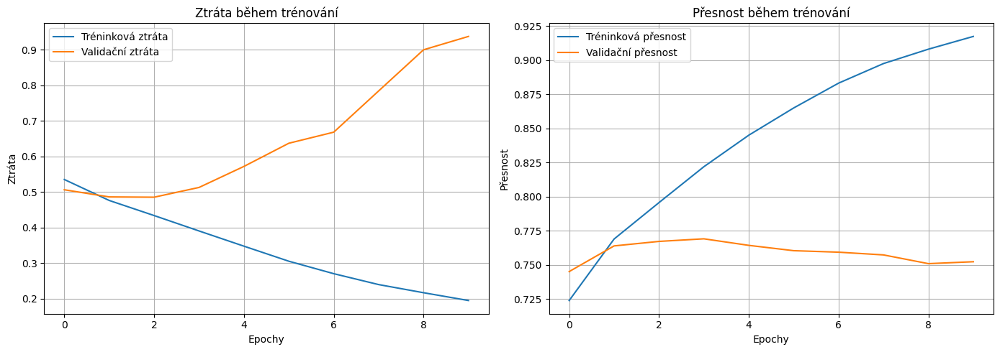

In [120]:
plot_training_history(history_8)

In [121]:
print(f"Přesnost modelu 7: {acc_7:.4f}")
print(f"Přesnost modelu 8: {acc_8:.4f}")

Přesnost modelu 7: 0.7367
Přesnost modelu 8: 0.7473


### Optuna vizualizace

In [122]:
fig = plot_optimization_history(study)
fig.update_layout(title="Historie optimalizace")
fig.show()

In [123]:
fig = plot_parallel_coordinate(study)
fig.update_layout(title="Paralelní souřadnice")
fig.show()

In [124]:
fig = plot_param_importances(study)
fig.update_layout(title="Důležitost parametrů")
fig.show()

In [125]:
fig = plot_contour(study)
fig.update_layout(title="Obrysový graf")
fig.show()

In [126]:
fig = plot_slice(study)
fig.update_layout(title="Graf řezu")
fig.show()

In [127]:
fig = plot_edf(study)
fig.update_layout(title="Empirická distribuční funkce")
fig.show()

In [128]:
fig = plot_timeline(study)
fig.update_layout(title="Timeline")
fig.show()

In [129]:
fig = plot_rank(study)
fig.update_layout(title="Rank")
fig.show()

## Model 9 - DisilBert base fine tuned SST 2 English

In [130]:
BATCH_SIZE = 16 # změněno z 64 na 16 pro kompatibilitu s GPU
EPOCHS = 1 		# změněno z 10 na 1 pro rychlejší trénink, jedna epocha by měla stačit pro rychlé testování

In [131]:
model_name = "distilbert-base-uncased-finetuned-sst-2-english"
tokenizer = DistilBertTokenizer.from_pretrained(model_name)
distilbert_model = TFDistilBertForSequenceClassification.from_pretrained(model_name, num_labels=2)

All PyTorch model weights were used when initializing TFDistilBertForSequenceClassification.

All the weights of TFDistilBertForSequenceClassification were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFDistilBertForSequenceClassification for predictions without further training.


In [132]:
def tokenize_data(texts, labels, tokenizer, max_length):
    encodings = tokenizer(
        list(texts),
        truncation=True,
        padding='max_length',
        max_length=max_length,
        return_tensors='tf'
    )
    
    input_dict = {
        'input_ids': encodings['input_ids'],
        'attention_mask': encodings['attention_mask'],
    }
    
    if 'token_type_ids' in encodings:
        input_dict['token_type_ids'] = encodings['token_type_ids']
    
    dataset = tf.data.Dataset.from_tensor_slices((
        input_dict,
        tf.one_hot(labels.astype('int32'), depth=2)
    ))
    
    return dataset

In [133]:
train_dataset = tokenize_data(X_train, y_train, tokenizer, SEQ_LENGTH).batch(BATCH_SIZE)
val_dataset = tokenize_data(X_val, y_val, tokenizer, SEQ_LENGTH).batch(BATCH_SIZE)
test_dataset = tokenize_data(X_test, y_test, tokenizer, SEQ_LENGTH).batch(BATCH_SIZE)

In [134]:
optimizer, _ = create_optimizer(
    init_lr=2e-5,
    num_train_steps=len(train_dataset) * EPOCHS,
    num_warmup_steps=int(0.1 * len(train_dataset) * EPOCHS)
)

distilbert_model.compile(
    optimizer=optimizer,
	loss='binary_crossentropy',
    metrics=['accuracy']
)

In [135]:
start_time = time.time()
history_9 = distilbert_model.fit(
	train_dataset,
	validation_data=val_dataset,
	epochs=EPOCHS
)
train_time_9 = time.time() - start_time
print(f"Trénink modelu DisilBert base fine tuned SST 2 English trval {train_time_9:.2f} sekund.")

I0000 00:00:1749878524.028036   14432 service.cc:152] XLA service 0x7543c0005420 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1749878524.028097   14432 service.cc:160]   StreamExecutor device (0): NVIDIA GeForce RTX 2070, Compute Capability 7.5
2025-06-14 07:22:04.052625: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1749878525.321868   14432 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


5000/5000 [==============================] - 1377s 269ms/step - loss: 0.9101 - accuracy: 0.7478 - val_loss: 0.4916 - val_accuracy: 0.7688
Trénink modelu DisilBert base fine tuned SST 2 English trval 1376.79 sekund.


625/625 [==============================] - 51s 76ms/step


2025-06-14 07:45:35.115139: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Bert Tiny a jeho přesnost: 0.7675

Klasifikační zpráva pro Bert Tiny:
              precision    recall  f1-score   support

       Fresh       0.76      0.78      0.77      4906
      Rotten       0.78      0.76      0.77      5094

    accuracy                           0.77     10000
   macro avg       0.77      0.77      0.77     10000
weighted avg       0.77      0.77      0.77     10000



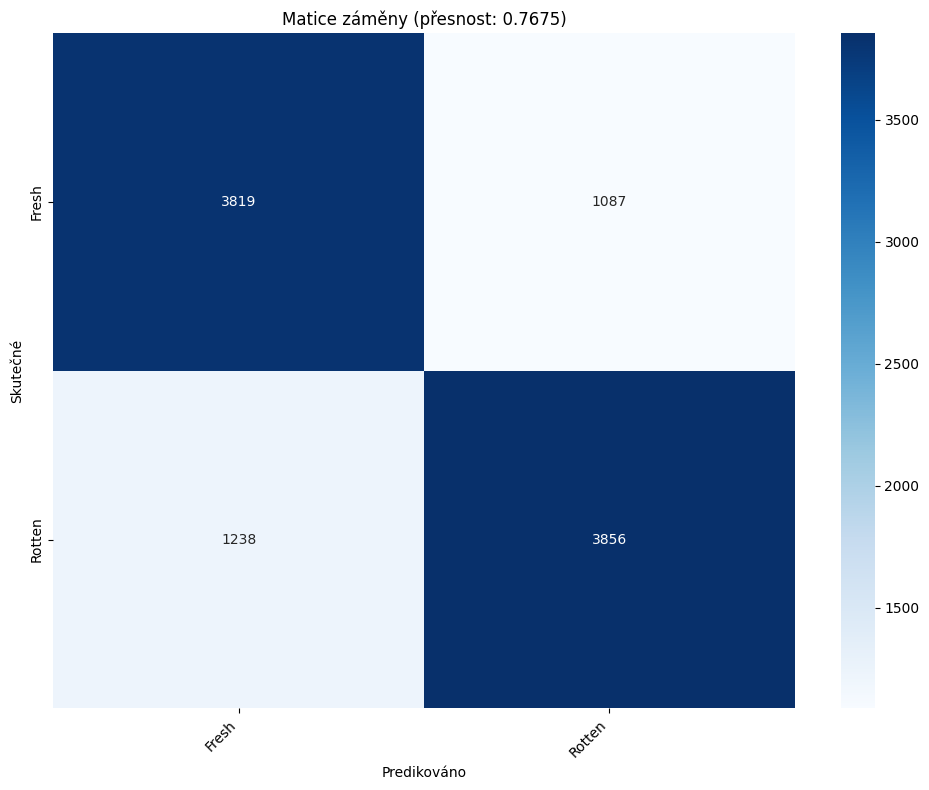

In [136]:
predictions = distilbert_model.predict(test_dataset)
y_pred = np.argmax(predictions.logits, axis=1)
y_true = np.argmax(tf.concat([y for _, y in test_dataset], axis=0).numpy(), axis=1)

acc_9 = accuracy_score(y_true, y_pred)
report_9 = classification_report(y_true, y_pred, target_names=class_names)

print(f"Bert Tiny a jeho přesnost: {acc_9:.4f}")
print("\nKlasifikační zpráva pro Bert Tiny:")
print(report_9)

cm = confusion_matrix(y_true, y_pred)
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
           xticklabels=class_names,
           yticklabels=class_names)
plt.xlabel('Predikováno')
plt.ylabel('Skutečné')
plt.title(f"Matice záměny (přesnost: {acc_9:.4f})")
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

In [137]:
print(f"Předešlý nejlepší model (Model 8): {acc_8:.4f}")
print(f"DisilBert base fine tuned SST 2 English (Model 9): {acc_9:.4f}")

Předešlý nejlepší model (Model 8): 0.7473
DisilBert base fine tuned SST 2 English (Model 9): 0.7675


# Závěr

In [ ]:
def model_size(model):
	return model.count_params() * 4 / (1024 * 1024)

def distilbert_model_size(model):
	return model.count_params() * 4 / (1024 * 1024)

In [166]:
results = {
	'Model': ['Model 1', 'Model 2', 'Model 3', 'Model 4', 'Model 5', 'Model 6', 'Model 7', 'Model 8', 'Model 9'],
	'Train Time (s)': [train_time_1, train_time_2, train_time_3, train_time_4, train_time_5, train_time_6, train_time_7, train_time_8, train_time_9],
	'Accuracy': [acc_1, acc_2, acc_3, acc_4, acc_5, acc_6, acc_7, acc_8, acc_9],
	'Parameters': [
		model_1.count_params(),
		model_2.count_params(),
		model_3.count_params(),
		model_4.count_params(),
		model_5.count_params(),
		model_6.count_params(),
		model_7.count_params(),
		model_8.count_params(),
		distilbert_model.count_params()
	],
	'Size (MB)': [
		model_size(model_1),
		model_size(model_2),
		model_size(model_3),
		model_size(model_4),
		model_size(model_5),
		model_size(model_6),
		model_size(model_7),
		model_size(model_8),
		distilbert_model_size(distilbert_model)
	]
}
comparison_df = pd.DataFrame(results)
comparison_df['Train Time (min)'] = comparison_df['Train Time (s)'].apply(lambda x: x / 60)
comparison_df['Train Time (s)'] = comparison_df['Train Time (s)'].apply(lambda x: f"{x:.2f} s")
comparison_df['Train Time (min)'] = comparison_df['Train Time (min)'].apply(lambda x: f"{x:.2f} min")
comparison_df['Accuracy'] = comparison_df['Accuracy'].apply(lambda x: f"{x:.4f}")
comparison_df['Size (MB)'] = comparison_df['Size (MB)'].apply(lambda x: f"{x:.2f} MB")
comparison_df['Parameters'] = comparison_df['Parameters'].apply(lambda x: f"{x:,}")
comparison_df

,Model,Train Time (s),Accuracy,Parameters,Size (MB),Train Time (min)
0,Model 1,377.84 s,0.7286,"2,193,281",8.37 MB,6.30 min
1,Model 2,324.73 s,0.7338,"2,193,281",8.37 MB,5.41 min
2,Model 3,634.45 s,0.7390,"2,616,129",9.98 MB,10.57 min
3,Model 4,713.76 s,0.6959,"3,479,745",13.27 MB,11.90 min
4,Model 5,1112.13 s,0.7427,"2,879,297",10.98 MB,18.54 min
5,Model 6,436.99 s,0.7283,"2,616,386",9.98 MB,7.28 min
6,Model 7,449.57 s,0.7367,"2,378,370",9.07 MB,7.49 min
7,Model 8,1759.68 s,0.7473,"2,259,846",8.62 MB,29.33 min
8,Model 9,1376.79 s,0.7675,"66,955,010",255.41 MB,22.95 min


## Model 1 vs 2 - souboj embeddingů

In [170]:
comparison_df.iloc[0:2]

,Model,Train Time (s),Accuracy,Parameters,Size (MB),Train Time (min)
0,Model 1,377.84 s,0.7286,"2,193,281",8.37 MB,6.30 min
1,Model 2,324.73 s,0.7338,"2,193,281",8.37 MB,5.41 min


### Shrnutí Modelů 1 a 2

- **Model 1** (🛠️ Custom Embedding):
	- Tréninkový čas: **377.84 s** (6.30 min)
	- Přesnost: **72.86 %**
	- Počet parametrů: **2,193,281**
	- Velikost: **8.37 MB**

- **Model 2** (📚 GloVe Embedding):
	- Tréninkový čas: **324.73 s** (5.41 min)
	- Přesnost: **73.38 %**
	- Počet parametrů: **2,193,281**
	- Velikost: **8.37 MB**

**Závěr**: Model 2 (📚 GloVe) dosáhl mírně vyšší přesnosti (o 0.52 %) a zároveň měl kratší tréninkový čas než Model 1 (🛠️ Custom).

## Model 3 a 4 - více vrstev 

In [168]:
comparison_df.iloc[2:4]

,Model,Train Time (s),Accuracy,Parameters,Size (MB),Train Time (min)
2,Model 3,634.45 s,0.7390,"2,616,129",9.98 MB,10.57 min
3,Model 4,713.76 s,0.6959,"3,479,745",13.27 MB,11.90 min


### Shrnutí Modelů 3 a 4 - Více vrstev, více problémů? 🤔

- **Model 3** (➕ Přidané vrstvy oproti Modelu 2):  
	- ⏱️ Tréninkový čas: **634.45 s** (10.57 min)  
	- 🎯 Přesnost: **73.90 %**  
	- 🧮 Počet parametrů: **2,616,129**  
	- 💾 Velikost: **9.98 MB**  

- **Model 4** (➕ Ještě více vrstev):  
	- ⏱️ Tréninkový čas: **713.76 s** (11.90 min)  
	- 🎯 Přesnost: **69.59 %**  
	- 🧮 Počet parametrů: **3,479,745**  
	- 💾 Velikost: **13.27 MB**  

**Závěr**: Přidání více vrstev v Modelu 4 vedlo k delšímu tréninkovému času (+1.33 min), větší velikosti modelu (+3.29 MB), ale **nižší přesnosti** (-4.31 %). Model 3 je tedy lepší volbou! 🚀

## Model 5 a 6 - více dvousměrných vrstev a Attention vrstva

In [171]:
comparison_df.iloc[4:6]

,Model,Train Time (s),Accuracy,Parameters,Size (MB),Train Time (min)
4,Model 5,1112.13 s,0.7427,"2,879,297",10.98 MB,18.54 min
5,Model 6,436.99 s,0.7283,"2,616,386",9.98 MB,7.28 min


### Shrnutí Modelů 5 a 6 - Více dvousměrných vrstev a Attention vrstva 🧠✨

- **Model 5** (➕ Více dvousměrných vrstev):  
	- ⏱️ Tréninkový čas: **1112.13 s** (18.54 min)  
	- 🎯 Přesnost: **74.27 %**  
	- 🧮 Počet parametrů: **2,879,297**  
	- 💾 Velikost: **10.98 MB**  

- **Model 6** (➕ Attention vrstva):  
	- ⏱️ Tréninkový čas: **436.99 s** (7.28 min)  
	- 🎯 Přesnost: **72.83 %**  
	- 🧮 Počet parametrů: **2,616,386**  
	- 💾 Velikost: **9.98 MB**  

**Závěr**: Model 5 s více dvousměrnými vrstvami dosáhl vyšší přesnosti (+1.44 %), ale za cenu delšího tréninkového času (+11.26 min) a větší velikosti modelu (+1 MB). Model 6 s attention vrstvou je lehčí a rychlejší, ale méně přesný. 🚀

## Model 7 a 8 - All in One a Optuna - souboj nejlepších 

In [174]:
comparison_df.iloc[6:8]

,Model,Train Time (s),Accuracy,Parameters,Size (MB),Train Time (min)
6,Model 7,449.57 s,0.7367,"2,378,370",9.07 MB,7.49 min
7,Model 8,1759.68 s,0.7473,"2,259,846",8.62 MB,29.33 min


In [176]:
print("Nejlepší parametry z optimalizace:")
for key, value in study.best_trial.params.items():
	print(f"{key}: {value}")

Nejlepší parametry z optimalizace:
lstm_units: 87
lstm_dropout: 0.38529791488919807
dense1_units: 210
dense1_dropout: 0.36838315927084886
dense2_units: 106
dense2_dropout: 0.24813867890931726
learning_rate: 0.0011103647313054626
batch_size: 16


### Shrnutí Modelů 7 a 8 - 🏆 Souboj nejlepších

- **Model 7** (🌟 Kombinace všeho: dvousměrné vrstvy, Attention, více vrstev):  
	- ⏱️ Tréninkový čas: **449.57 s** (7.49 min)  
	- 🎯 Přesnost: **73.67 %**  
	- 🧮 Počet parametrů: **2,378,370**  
	- 💾 Velikost: **9.07 MB**  

- **Model 8** (🧪 Hyperparametrická optimalizace pomocí Optuna):  
	- ⏱️ Tréninkový čas: **1759.68 s** (29.33 min)  
	- 🎯 Přesnost: **74.73 %**  
	- 🧮 Počet parametrů: **2,259,846**  
	- 💾 Velikost: **8.62 MB**  

**Nejlepší parametry z Optuna optimalizace (Model 8):**  
- 🔢 **LSTM jednotky:** 87  
- 💧 **LSTM dropout:** 0.385  
- 🧠 **Dense vrstvy:** 210 → 106  
- 💧 **Dense dropout:** 0.368 → 0.248  
- 🚀 **Rychlost učení:** 0.0011  
- 📦 **Velikost dávky:** 16  

**Závěr**:  
Model 8 dosáhl **nejvyšší přesnosti** (+1.06 % oproti Modelu 7) díky optimalizaci hyperparametrů, ale za cenu **delšího tréninkového času** (+21.84 min). Pokud je prioritou přesnost, Model 8 je vítěz. Pokud je prioritou rychlost, Model 7 je lepší volbou. 🚀

## Model 9 - DisilBert base fine tuned SST 2 English - ten nejlepší

In [177]:
comparison_df.iloc[7:9]

,Model,Train Time (s),Accuracy,Parameters,Size (MB),Train Time (min)
7,Model 8,1759.68 s,0.7473,"2,259,846",8.62 MB,29.33 min
8,Model 9,1376.79 s,0.7675,"66,955,010",255.41 MB,22.95 min


- **Model 9 (DistilBERT)** 🤖:
	- Dosáhl **vyšší přesnosti** (+2.02 %).
	- Má **výrazně více parametrů** (66M vs 2M) a je **větší** (255 MB vs 8.62 MB).
	- Trénink byl **rychlejší** o ~6.38 minut.
	- Kvůli omezením GPU jsme museli **zmenšit batch size z 64 na 16** a spustit pouze **jednu epochu**.

- **Model 8 (Optuna)** 🧪:
	- Lehčí a menší model, vhodnější pro nasazení na zařízení s omezenými zdroji.
	- Přesnost je o něco nižší, ale stále velmi dobrá.

**Závěr**: Pokud je prioritou přesnost a výkon, **Model 9 (DistilBERT)** je vítěz. Pokud je prioritou efektivita a menší velikost, **Model 8 (Optuna)** je lepší volbou. 🚀

## Vizualizace výsledků

### Přesnost jednotlivých modelů

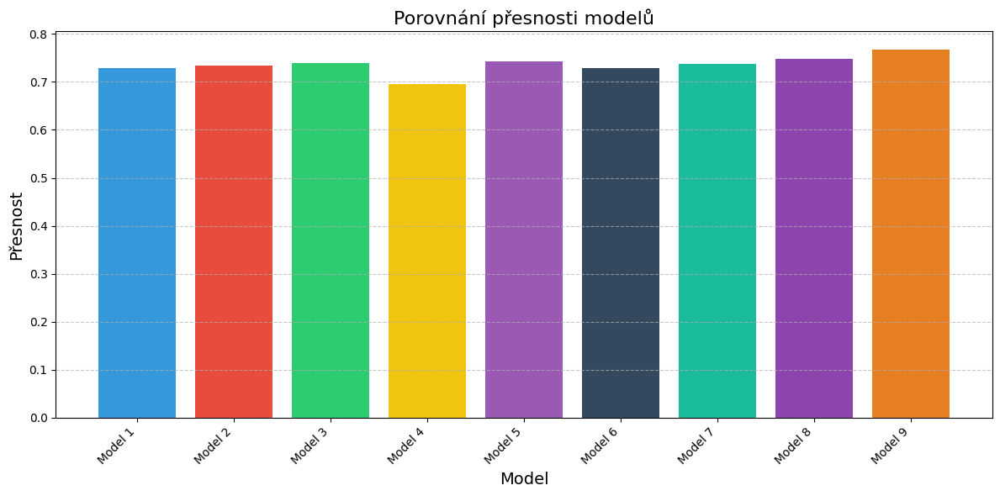

In [ ]:
plt.figure(figsize=(12, 6))
accuracies = comparison_df['Accuracy'].apply(lambda x: float(x))
plt.bar(comparison_df['Model'], accuracies, color=['#3498db', '#e74c3c', '#2ecc71', '#f1c40f', '#9b59b6', '#34495e', '#1abc9c', '#8e44ad', '#e67e22'])
plt.title('Porovnání přesnosti modelů', fontsize=16)
plt.xlabel('Model', fontsize=14)
plt.ylabel('Přesnost', fontsize=14)
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

### Tréninkový čas jednotlivých modelů

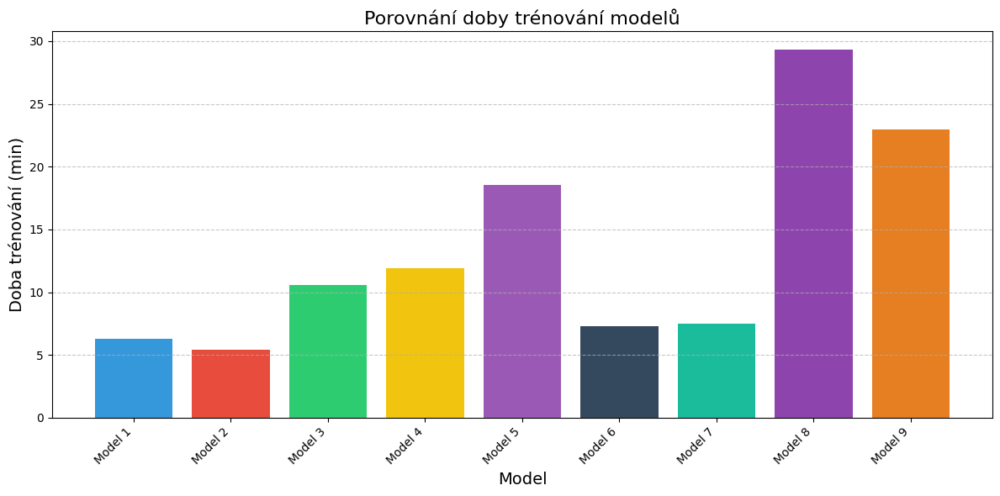

In [ ]:
plt.figure(figsize=(12, 6))
train_times = comparison_df['Train Time (min)'].apply(lambda x: float(x.split()[0]))
plt.bar(comparison_df['Model'], train_times, color=['#3498db', '#e74c3c', '#2ecc71', '#f1c40f', '#9b59b6', '#34495e', '#1abc9c', '#8e44ad', '#e67e22'])
plt.title('Porovnání doby trénování modelů', fontsize=16)
plt.xlabel('Model', fontsize=14)
plt.ylabel('Doba trénování (min)', fontsize=14)
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

### Porovnání velikosti modelů

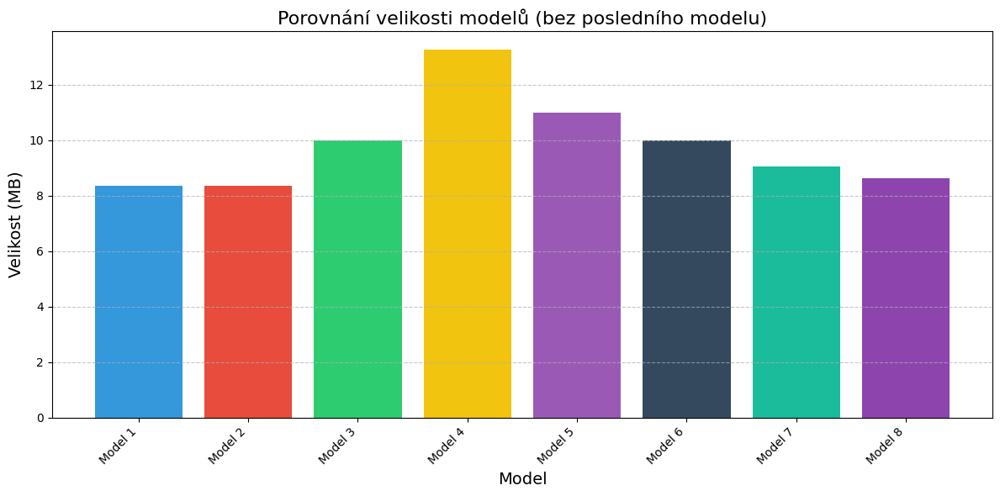

In [ ]:
plt.figure(figsize=(12, 6))
filtered_df = comparison_df.iloc[:-1]  # Exclude the last row (Model 9)
plt.bar(filtered_df['Model'], filtered_df['Size (MB)'].apply(lambda x: float(x.split()[0])), 
	color=['#3498db', '#e74c3c', '#2ecc71', '#f1c40f', '#9b59b6', '#34495e', '#1abc9c', '#8e44ad'])
plt.title('Porovnání velikosti modelů (bez posledního modelu)', fontsize=16)
plt.xlabel('Model', fontsize=14)
plt.ylabel('Velikost (MB)', fontsize=14)
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

# Deployment-ready pipeline UDĚLEJ MODEL, KTERÝ NEMÁ LAMBDA, TAKŽE TROJKU KLIDNĚ, AŽ PO PĚTKU